# Neural Style Transfer:
"In fine art, especially painting, humans have mastered the skill to create unique visual experiences through composing a complex interplay between the content and style of an image". Da questo concetto è stato sviluppato un sistema artificiale, basato su Deep neural network, in grado di simulare in qualche modo il gesto artistico di un umano e di creare immagini originali di alta qualità. Ciò viene implementato tramite l'utilizzo di due immagini di input, unite tra loro, una da cui viene estrapolato il contenuto e una da cui viene estrapolato lo stile.

Il task in questione prende il nome di Neural style transfer, inventato nel 2015 da Leon Gatys con la pubblicazione [A Neural Algorithm of Artitstic Style](https://arxiv.org/pdf/1508.06576.pdf). L'idea che sta alla base è quella di utilizzare delle reti convoluzionali pre-addestrate per estrarre le caratteristiche stilistiche di un'immagine (immagine di stile) e applicarle ad un'altra (immagine di contenuto).

In questo notebook ci concentriamo sull'implementazione e l'ottimizzazione del NST utilizzando diversi modelli preaddestrati come VGG19, VGG16, MobileNetV2 e ResNet50. Per la valutazione degli output esploriamo diverse metriche per valutare le immagini generate tra cui tra cui i [Global effects](https://www.researchgate.net/publication/350184156_Evaluate_and_improve_the_quality_of_neural_style_transfer) e il PSNR. Il risultato finale, sulla base di questo processo, sarà un'immagine che assomiglia molto all'immagine del contenuto ma che avrà uno stile molto vicino a quello dell'immagine di stile.

Come scheletro del notebook ci siamo basati e abbiamo preso ispirazione dal notebook di tensorflow in cui viene approfondito il task del NST [Notebook](https://www.tensorflow.org/tutorials/generative/style_transfer?hl=it)

##Import delle Librerie



*   ***wget***: è una libreria utilizzata per scaricare file da internet. Può essere usata per scaricare modelli pre-addestrati e i dataset da cui prenderemo poi le immagini di stile e di contenuto.
*   ***imageio***: è una libreria per la lettura e la scrittura di immagini. Nel contesto del NST è usata per leggere le tue immagini di stile e di contenuto in matrici numpy, che possono poi essere utilizzate come input per il tuo modello di rete neurale. Inoltre, può essere usata per salvare le immagini di output generate dal modello.
*   ***kaggle***: è una libreria ufficiale di Python per l'API di Kaggle. [Kaggle](https://www.kaggle.com/) è una piattaforma per la data science che ospita competizioni, set di dati, notebook di codice e discussioni. Questa libreria risulta utile per permetterci di scaricare i due dataset che useremo nel notebook.



In [ ]:
%%capture
!pip install wget
!pip install imageio
!pip install kaggle

In [ ]:
import wget
import os
import random
import shutil
import tensorflow as tf
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import imageio
import PIL
from PIL import Image
from PIL import ImageEnhance
import time
from IPython import display
from IPython.display import clear_output
import seaborn as sns
from skimage import img_as_float
from skimage.metrics import peak_signal_noise_ratio as psnr

##Datasets Download

###Creazione del Path per poter in seguito scaricare i datasets


In [ ]:
# Definiamo il percorso della directory dove si troveranno le credenziali di Kaggle.
# `os.path.expanduser('~/.kaggle')` espande il percorso "~/.kaggle" alla directory .kaggle nella tua home directory.
kaggle_dir = os.path.expanduser('~/.kaggle')

# Controlla se la directory di Kaggle esiste già.
# Se non esiste, la crea con `os.makedirs()`.
if not os.path.exists(kaggle_dir):
  os.makedirs(kaggle_dir)

# Scarica il file kaggle.json che contiene le tue credenziali API di Kaggle.
# Questo file è necessario per utilizzare l'API di Kaggle.
# Il comando wget -O specifica il percorso e il nome del file di output, il link dopo il comando è l'URL da cui si deve scaricare il file
!wget -O ~/.kaggle/kaggle.json "https://www.dropbox.com/s/4r6xtt9higaowor/kaggle.json?dl=0"

# Imposta i permessi del file kaggle.json a 600 (lettura e scrittura solo per il proprietario)
# Il comando chmod cambia i permessi del file. 600 significa che il proprietario del file può leggere e scrivere il file,
# ma nessun altro utente può accedervi. Questo è importante per proteggere le tue credenziali API.
!chmod 600 ~/.kaggle/kaggle.json

--2023-06-30 13:36:38--  https://www.dropbox.com/s/4r6xtt9higaowor/kaggle.json?dl=0
Resolving www.dropbox.com (www.dropbox.com)... 162.125.7.18, 2620:100:6025:18::a27d:4512
Connecting to www.dropbox.com (www.dropbox.com)|162.125.7.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/4r6xtt9higaowor/kaggle.json [following]
--2023-06-30 13:36:39--  https://www.dropbox.com/s/raw/4r6xtt9higaowor/kaggle.json
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc19d84eb9e74af38704508fb19b.dl.dropboxusercontent.com/cd/0/inline/B-8tPmuVvBxRxDlKc50Veq9aB9dPKpZ9xFADasfAgc8YDlcqTLX-zHNYdU928qqgWtrIS9IZsQyXUO1eiL_yoX3dIJctbSGaQwMZAOYBrrfwo6SZCajMbDdx1--C6j-sx7yVhB27MKzioV9yO320l6A7nPJXeNbvW1yt_JgA2lD_yw/file# [following]
--2023-06-30 13:36:39--  https://uc19d84eb9e74af38704508fb19b.dl.dropboxusercontent.com/cd/0/inline/B-8tPmuVvBxRxDlKc50Veq9aB9dPKpZ9xFADasfAgc8YDlcqTLX-zHNYdU928qqgWtrIS9IZsQyXU

###Dataset di contenuto
- [*Watermarked / Not watermarked images:*](https://www.kaggle.com/datasets/felicepollano/watermarked-not-watermarked-images) è un dataset preso da Kaggle contenente immagini RGB di elementi casuali, con e senza filigrana. Il dataset è suddiviso in una cartella di train contenente l'80% delle immagini e una cartella test con il rimanente 20%. Ognuna di queste cartelle ha a sua volta due cartelle in cui sono contenute immagini con watermark o senza watermark. Per il nostro task non dovendo classificare abbiamo deciso di utilizzare soltanto le immagini senza watermark della cartella di train.

  Abbiamo scelto questo dataset per la sua varietà di immagini, raffiguranti elementi di ogni tipo e quindi permettendo di avere una rappresentazione più completa della realtà
      
    



In [ ]:
!kaggle datasets download -d felicepollano/watermarked-not-watermarked-images --force

100% 698M/698M [00:33<00:00, 22.3MB/s]
100% 698M/698M [00:33<00:00, 22.0MB/s]


###Dataset di stile

- [Best Artworks of All Time](https://www.kaggle.com/datasets/ikarus777/best-artworks-of-all-time): è un dataset preso da Kaggle contenente una collezione di opere d'arte provenienti da diverse epoche e stili artistici. Il dataset contiene informazioni su 8355 di opere d'arte, inclusi dipinti e disegni, realizzati dai 50 artisti più influenti della storia.
Il contenuto è suddiviso in tre cartelle:
    - ‘images’ - contenente delle immagini RGB ad alta dimensionalità
    - ‘resized’ - contiene le stesse immagini con una dimensione minore, permette di scaricare meno dati e processare il modello più velocemente.
    - ‘artist.csv’ - un file csv che contiente informazioni testuali su ogni artista
      
  Abbiamo scelto questo dataset perchè è molto ricco dal punto di vista artistico e permette quindi di avere a disposizione una vasta gamma di stili da poter applicare alle immagini di contenuto  

In [ ]:
!kaggle datasets download -d ikarus777/best-artworks-of-all-time --force

100% 2.29G/2.29G [02:04<00:00, 20.2MB/s]
100% 2.29G/2.29G [02:04<00:00, 19.7MB/s]


###Estrazione dei dati:

In [ ]:
#Creazione della cartella che conterrà entrambi i datasets
!mkdir dataset_folder
#Per ogni tipo di immagine che sarà di studio durante il notebook viene creata una cartella all'interno della quale questa verrà salvata
!mkdir "/content/dataset_folder/images"
!mkdir "/content/dataset_folder/images/OG"
!mkdir "/content/dataset_folder/images/WEIGHT"
!mkdir "/content/dataset_folder/images/CONTRAST"
!mkdir "/content/dataset_folder/images/POSTERIZE"
!mkdir "/content/dataset_folder/images/LR"


#I dati sono scaricati in formato zip, per essere utiizzati dovranno essere estratti, vengono estratti temporaneamente in due cartelle temp1 e temp2
!unzip -q '/content/best-artworks-of-all-time.zip' -d dataset_folder/temp1
!unzip -q '/content/watermarked-not-watermarked-images.zip' -d dataset_folder/temp2

###Pulizia delle directory:
Una volta estratti tutti i dati da entrambe le zip bisogna inserirli nelle giuste cartelle e prendere solo ciò che ci servirà nel continuo del progetto

In [ ]:
  #sposto nella cartella base_image la cartella no_watermark della cartella train del dataset di contenuto, tutti gli altri dati d
!mv dataset_folder/temp2/wm-nowm/train/no-watermark dataset_folder/base_image
!mv dataset_folder/temp1/images/images dataset_folder/style
!mv dataset_folder/temp1/artists.csv dataset_folder/style.csv

!rm -rf best-artworks-of-all-time.zip
!rm -rf watermarked-not-watermarked-images.zip
!rm -rf dataset_folder/temp1/
!rm -rf dataset_folder/temp2/

##Preprocessing del Dataset e scelta delle immagini:

###Funzione crop and scale
Le immagini vengono ritagliate e ridimensionate in una versione uniforme. Tra i motivi si può avere un fattore puramente estetico, in quanto si hanno in output delle immagini tutte della stessa dimensionalità (512 x 512), ma il motivo principale per cui scaliamo le immagini alla stessa dimensione è il calcolo della metrica di valutazione PSNR tra l'immagine finale e l'immagine del contenuto. Il calcolo di questa metrica necessita infatti che la dimensione tra le due immagini sia la stessa, e quindi dato che l'immagine finale avrà una dimensione di (512 x 512) serve che l'immagine di contenuto abbia la stessa dimensione, in quanto il calcolo di questa metrica lavora pixel per pixel.

La funzione prende in input due percorsi: il percorso della cartella da cui prendere le immagini da scalare, e quello della cartella che conterrà l'output, ovvero le immagini scalate.
La cartella di input viene

In [ ]:
def crop_and_scale_images_in_directory(input_path, output_path):
    # Ottiene la lista dei nomi dei file immagine presenti nel percorso di input
    image_files = os.listdir(input_path)

    for image_file in image_files:
        # Costruisce il percorso completo dell'immagine di input
        input_image_path = os.path.join(input_path, image_file)

        # Carica l'immagine di input
        input_image = tf.io.read_file(input_image_path)
        input_image = tf.image.decode_image(input_image, channels=3)

        # Ritaglia e ridimensiona l'immagine
        cropped_scaled_image = crop_and_scale_image(input_image)

        # Converte l'immagine nel tipo di dati uint8
        cropped_scaled_image = tf.cast(cropped_scaled_image, tf.uint8)

        # Costruisce il percorso completo dell'immagine di output
        output_image_path = os.path.join(output_path, image_file)

        # Salva l'immagine ritagliata e ridimensionata
        tf.io.write_file(output_image_path, tf.image.encode_jpeg(cropped_scaled_image))


def crop_and_scale_image(image):
    # Ottiene le dimensioni dell'immagine originale
    original_height = tf.shape(image)[0]
    original_width = tf.shape(image)[1]

    # Determina la lunghezza del lato del ritaglio quadrato,
    # questa funzione calcola il lato più corto dell'immagine, prende due numeri e restituisce il minimo tra questi
    side_length = tf.minimum(original_height, original_width)

    # Calcola il punto di partenza per il ritaglio
    start_y = (original_height - side_length) // 2
    start_x = (original_width - side_length) // 2

    # Ritaglia l'immagine a un rapporto quadrato
    cropped_image = tf.image.crop_to_bounding_box(image, start_y, start_x, side_length, side_length)

    # Ridimensiona l'immagine ritagliata a 512x512 pixel
    resized_image = tf.image.resize(cropped_image, [512, 512], method=tf.image.ResizeMethod.BILINEAR)

    return resized_image

In [ ]:
inpath= "dataset_folder/base_image" #path delle immagini che devono essere resizeate
outpath="dataset_folder/resized_base_image" #path dove verranno salvate le immagini resizeate
crop_and_scale_images_in_directory(inpath, outpath) #le immagini verranno scalate per avere tutte la stessa dimensione di 512x512

###Selezione degli artisti o dello stile
L'utente può scegliere manualmente un artista o uno stile tramite il menù a tendina, oppure possono essere entrembi scelti randomicamente.
Se viene scelto uno stile successivamente verrà estratto casualmente un artista che fa parte di quello stile.

Per attribuire il nome o lo stile dell'artista all'opera corrispondente viene eseguita un'operazione di filtraggio dei dati all'interno del DataFrame "ARTISTS" in base alla scelta dell'utente.

Se l'utente seleziona "style" o "random", viene visualizzato lo stile scelto e vengono selezionati gli artisti nel DataFrame che corrispondono a quel determinato stile. Se invece l'utente seleziona "artist", viene selezionato l'artista specifico nel DataFrame.

Successivamente, vengono visualizzati il nome dell'artista, lo stile e il numero di dipinti dell'artista o degli artisti selezionati, restituendo il DataFrame risultante.

In [ ]:
#lettura del file style.csv
ARTISTS = pd.read_csv('/content/dataset_folder/style.csv')

#viene creata una lista con tutti gli stili disponibili che serve per determinare lo stile in caso l'utente scelga l'opzione 'random'
styles = ["Expressionism","Abstractionism","Social Realism","Muralism","Impressionism","Impressionism","Surrealism","Realism","Byzantine Art","Post-Impressionism","Symbolism","Art Nouveau","Northern Renaissance","Suprematism","Cubism","Baroque","Romanticism","Primitivism","Mannerism","Proto Renaissance","Early Renaissance","High Renaissance","Post-Impressionism","Abstractionism","Neoplasticism","Pop Art"]

#gestione della scelta dell'utente
choice = 'artist' #@param {type: "string"} ["artist", "style", "random"]

if choice == 'style':
  style = 'Romanticism' # @param {type:"string"}["Expressionism","Abstractionism","Social Realism","Muralism","Impressionism","Impressionism","Surrealism","Realism","Byzantine Art","Post-Impressionism","Symbolism","Art Nouveau","Northern Renaissance","Suprematism","Cubism","Baroque","Romanticism","Primitivism","Mannerism","Proto Renaissance","Early Renaissance","High Renaissance","Post-Impressionism","Abstractionism","Neoplasticism","Pop Art"]
elif choice == 'artist':
  artist = 'Vincent van Gogh' #@param{type: "string"} ["Amedeo Modigliani","Vasiliy Kandinskiy","Diego Rivera","Claude Monet","Rene Magritte","Salvador Dali","Edouard Manet","Andrei Rublev","Vincent van Gogh","Gustav Klimt","Hieronymus Bosch","Kazimir Malevich","Mikhail Vrubel","Pablo Picasso","Peter Paul Rubens","Pierre-Auguste Renoir","Francisco Goya","Frida Kahlo","El Greco","Albrecht Dürer","Alfred Sisley", "Pieter Bruegel","Marc Chagall","Giotto di Bondone","Sandro Botticelli","Caravaggio","Leonardo da Vinci","Diego Velazquez","Henri Matisse","Jan van Eyck","Edgar Degas","Rembrandt","Titian","Henri de Toulouse-Lautrec","Gustave Courbet","Camille Pissarro","William Turner","Edvard Munch","Paul Cezanne","Eugene Delacroix","Henri Rousseau","Georges Seurat","Paul Klee","Piet Mondrian","Joan Miro","Andy Warhol","Paul Gauguin","Raphael","Michelangelo","Jackson Pollock"]
  ARTISTS = ARTISTS[ARTISTS['name'].str.contains(artist)].reset_index()
  artist = artist.replace(' ', '_')#il nome degli artisti viene formattato e adattato al nome presente nei percorsi delle imamgini
else:
  style = random.choice(styles) #se l'utente sceglie l'opzione 'random' viene scelto uno stile casuale da quelli all'interno della lista 'styles'

#viene poi visualizzato il DataFrame degli artisti scelti
if choice == 'style' or choice == 'random':
  print ("Stile scelto: ", style)
  ARTISTS = ARTISTS[ARTISTS['genre'].str.contains(style)].reset_index() #visualizzazione degli artisti dello stile scelto

ARTISTS = ARTISTS[['name','genre', 'paintings']] #vengono visualizzati nome, genere e dipinti degli artisti scelti
ARTISTS


,name,genre,paintings
0,Vincent van Gogh,Post-Impressionism,877


In [ ]:
#Vengono definiti i percorsi delle cartelle di stile e contenuto
CONTENT_PATH = '/content/dataset_folder/resized_base_image'
STYLE_PATH = '/content/dataset_folder/style'

In [ ]:
#se l'artista non viene scelto manualmente viene scelto randomicamente
if choice != 'artist':
  ARTIST_NAMES = ARTISTS['name'].str.replace(' ', '_').values
  #L'artista viene scelto randomicamente dalla lista dei nomi degli artisti che fanno parte del genere selezionato
  artist = random.choice(ARTIST_NAMES)
  print ("artista scelto: ", artist)

#viene creato il path dell'immagine di stile
STYLE_IMAGE = random.choice(os.listdir(os.path.join(STYLE_PATH, artist)))
STYLE_IMAGE = STYLE_PATH + '/' + artist + '/' + STYLE_IMAGE

In [ ]:
#viene scelta randomicamente un'immagine dalla cartella delle immagini di contenuto e creato il percorso dell'immagine che verrà poi editata
CONTENT = random.choice(os.listdir(os.path.join(CONTENT_PATH)))
IMAGE = CONTENT_PATH + '/' + CONTENT #viene creato il path dell'immagine di contenuto

In [ ]:
image_path = IMAGE
image = Image.open(image_path)
CONTENT_IMAGE = 'dataset_folder/images/OG/content_image.png'  # Modifica il percorso e il nome del file a tua scelta
image.save(CONTENT_IMAGE) #salviamo l'immagine di contenuto

Vengono stampate a schermo le immagini selezionate randomicamente che saranno protagoniste del processo di Neural Style transfer che porterà come output un'immagine in cui gli elementi dei due input di partenza sono fusi tra loro

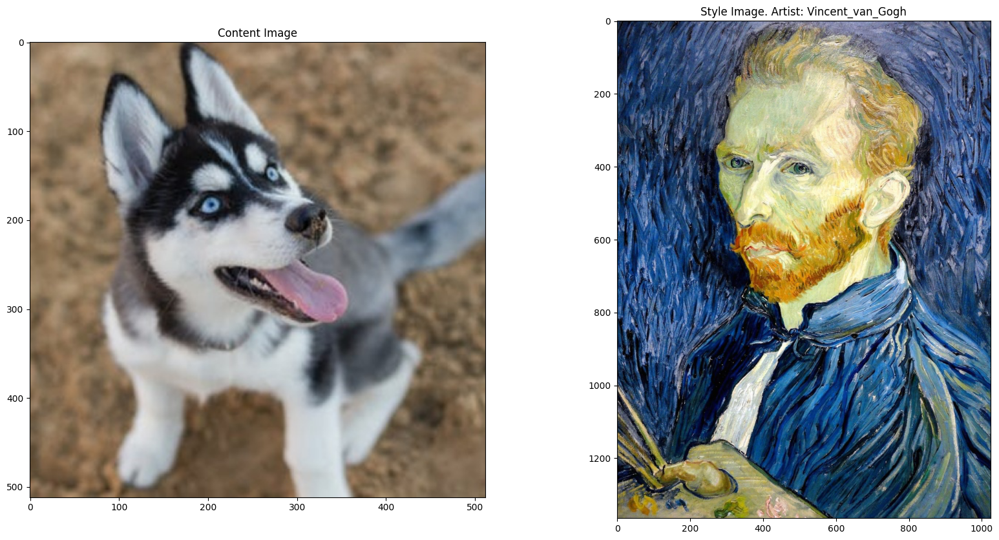

In [ ]:
#caricamento delle immagini sia di contenuto che di stile
CONTENT_IMAGE = '/content/dataset_folder/images/OG/content_image.png'
content_img = plt.imread(CONTENT_IMAGE)
style_img = plt.imread(STYLE_IMAGE)

# display the initial images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10), squeeze=True)

# content and style images side-by-side
ax1.imshow(content_img)
ax1.set_title('Content Image')
ax2.imshow(style_img)
ax2.set_title('Style Image. Artist: ' + artist)

plt.show()

##Baseline Utilizzata (TfHub)

Attraverso la funzione `Tensor_to_image` viene trasformato un numpyarray in una Python Imaging Library (PIL) image object che potrà essere ulteriormente processata o visualizzata.

In [ ]:
def tensor_to_image(tensor):
  # Moltiplicando il tensore per 255, stiamo portando i valori del tensore (che solitamente sono compresi tra 0 e 1) nella gamma [0,255]. Questo è un tipico range di valori per i pixel di un'immagine.
  tensor = tensor*255
  tensor = np.array(tensor, dtype=np.uint8)
  # Convertiamo il tensore in un array di NumPy con il tipo di dato uint8. Questo è il tipo di dato standard usato per rappresentare i valori dei pixel nelle immagini, perché può rappresentare interi da 0 a 255.

  if np.ndim(tensor)>3:
    assert tensor.shape[0] == 1
    # Controlliamo se il tensore ha più di tre dimensioni. Se è così, ci aspettiamo che la dimensione del batch (la prima dimensione) sia 1. Se non è così, il programma solleverà un errore.

    tensor = tensor[0]
    # Se il tensore ha una dimensione del batch, la rimuoviamo selezionando solo la prima immagine del batch.

  return PIL.Image.fromarray(tensor)
  # Infine, convertiamo l'array di NumPy in un oggetto immagine PIL (Python Imaging Library) che può essere visualizzato o salvato su disco.

La funzione *load_image* è progettata per caricare un'immagine da un percorso di file specificato, processarla e prepararla per l'utilizzo nel contesto delle reti neurali convoluzionali.

Legge l'immagine dal percorso del file specificato, l'immagine viene poi decodificata in un tensore a 3 canali (RGB). Converte il tipo di dati dell'immagine a float32 e normalizza i valori dei pixel nell'intervallo [0,1].
Calcola la dimensione del lato più lungo dell'immagine e determina un fattore di scala in base a questo e a un valore massimo predefinito (512 in questo caso). Ridimensiona l'immagine e alla fine aggiunge una nuova dimensione all'inizio del tensore, la "dimensione di batch"


Aggiunge una nuova dimensione all'inizio del tensore dell'immagine. Questa è la cosiddetta "dimensione del batch", che è comune nei contesti di machine learning, poiché le immagini sono spesso passate in batch a una rete neurale, non singolarmente.

In [ ]:
def load_image(path_to_img):
  max_dim = 512 #512 è la massima dimensione che può raggiungere l'immagine, se è maggiore verrà resizeata fino a raggiungerla
  img = tf.io.read_file(path_to_img)
  img = tf.image.decode_image(img, channels=3) #l'immagine è decodificata in un tensore con tre canali (Rosso, Verde e Blu)
  img = tf.image.convert_image_dtype(img, tf.float32) #questa conversione assicura che il range dei velori nei pixel sia tra [0,1]

  shape = tf.cast(tf.shape(img)[:-1], tf.float32) #viene fatto il cast dell'immagine escludendo l'ultima dimensione di essa
  long_dim = max(shape) #rappresenta la lunghezza del lato più grande dell'immagine
  scale = max_dim / long_dim #questo fattore verrà usato per fare il resize dell'immagine senza cambiare il suo aspect ratio

  new_shape = tf.cast(shape * scale, tf.int32) #nuova shape dell'immagine per il resizing

  img = tf.image.resize(img, new_shape) #il resizing vero e proprio viene fatto dalla funzione di tensorflow che prende in input l'immagine e la nuova shape, mantiene l'aspect ratio
  img = img[tf.newaxis, :] #aggiunge una nuova dimensione all'immagine (la dimensione batch) utile dato che molto spesso alle reti neurali le immagini vengono passate non singolarmente ma in batch
  return img

Tensorflow Hub è un repository di modelli di machine learning addestrati pronti per la messa a punto e implementabili ovunque. Per il task del neural style transfer viene caricato il modello addestrato [magenta/arbitrary-image-stylization](https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2). Esso riferimento ad un articolo del 2017 pubblicato da alcuni ricercatori di Google Brain in cui viene approfondito un altro metodo per approcciare il task del neural style transfer intitolato [Exploring the structure of a real-time, arbitrary neural
artistic stylization network](https://arxiv.org/pdf/1705.06830.pdf). Tf-Hub è un modello addestrato su più di 80.000 dipinti con stili differenti ed è in grado di generalizzare lavorando su dipindi mai visti prima. La base del suo funzionamento è l'utilizzo di due reti neurali, un SPN (style prediction network) e un STN (style transfer network) addestrati su molte immagini.
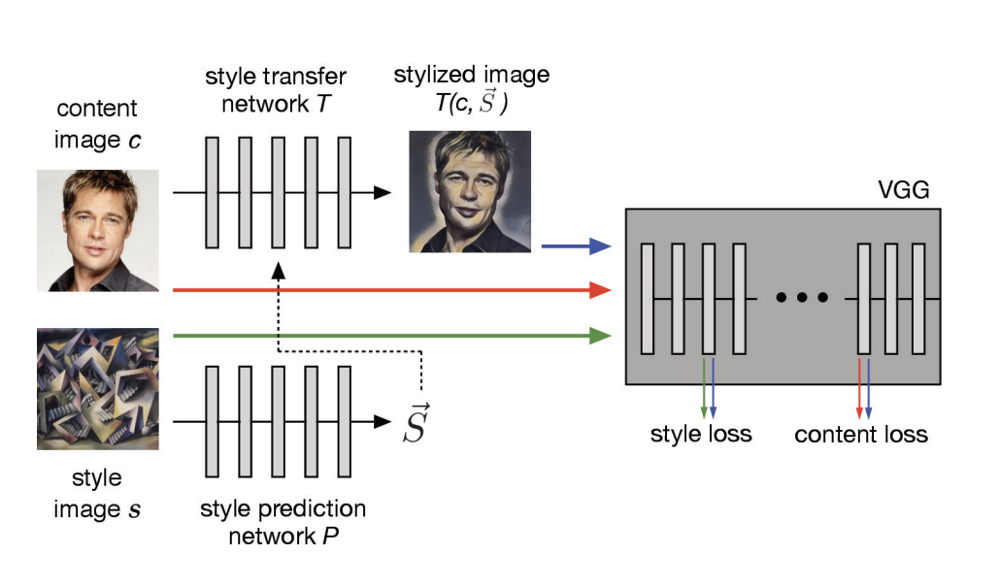




Lo Syle prediction network, implementato con il modello preaddestrato InceptionV3 al quale vengono aggiunti dei livelli densamente connessi per fare la previsione, è una rete neurale che impara con l'addestramento ad estrarre diversi aspetti stilistici come colori, textures e tratti dell'artista da un'immagine. Le SPN sono spesso create (come in questo caso) usando le CNNs per la loro abilità di catturare pattern spaziali e caratteristiche delle immagini in modo efficiente. La rete è composta da una serie di livelli convolutivi e poi finisce con qualche livello densamente connesso che permette di fare la previsione. La predizione fatta dalla rete è sotto forma di vettore di embedding e dovrebbe contenere le caratteristiche stilistiche dell'immagine che ha preso in input.

Lo Style transfer network addestrato contemporaneamente al primo (SPN) prende come input l'immagine di contenuto e il vettore di embedding predetto dall'altro network e restituisce una volta finito il processo di addestramento un'immagine stilizzata con le caratteristiche di stile provenienti del vettore di embedding e il contenuto dell'immagine dell'immagine di contenuto.

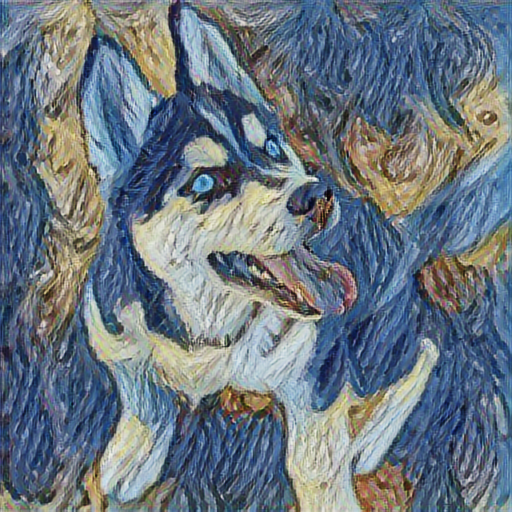

In [ ]:
import tensorflow_hub as hub

#le immagini di contenuto e di stile devono essere preparate prima di essere date in pasto al modello attraverso la funzione definita in precedenza load_image
content_image = load_image(CONTENT_IMAGE)
style_image = load_image(STYLE_IMAGE)


hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2') #caricamento del modello scelto per il task di NST
stylized_image = hub_model(tf.constant(content_image), tf.constant(style_image))[0] #vengono date le immagini in input al modello e si salva l'output restituito
baseline = tensor_to_image(stylized_image) #con la funzione definita precedentemente tensor_to_image trasformiamo da tensore a immagine
baseline.save("/content/dataset_folder/images/OG/baseline.png")
baseline.save("/content/dataset_folder/images/WEIGHT/baseline.png") #non potendo modificare i pesi di TFHUB utilizzeremo la stessa baseline anche per i confronti con pesi diversi
baseline

##Utilizzo costruzione dei modelli usando reti preaddestrate:

Durante lo sviluppo del progetto abbiamo svolto la nostra analisi utilizzando quattro modelli pre-addestrati che fanno parte della raccolta di [Keras](https://keras.io/api/applications/):


*   VGG19: è un modello di rete neurale convoluzionale (CNN) composto da 19 strati, tra cui strati di convoluzione e pooling seguiti da tre strati completamente connessi alla fine.
La sua caratteristica principale nel NST è la sua capacità di estrarre dettagli di livello medio e alto dalle immagini.

*   VGG16: è un modello di rete neurale convoluzionale (CNN), simile a VGG19 ma con una struttura più leggera a 16 strati. Come VGG19 presenta livelli convolutivi e di pooling seguiti da tre strati completamente connessi alla fine. Anche questo modello ha importanti capacità di estrazione di caratteristiche di diversi livelli dalle immagini.
*   ResNet50: è un modello che si basa sul concetto di blocchi residuali(introducono connessioni residue che consentono al modello di apprendere solo le modifiche incrementalmente, migliorando la capacità di creare reti neurali più profonde senza compromettere le prestazioni). E' composto da 50 livelli  che includono una combinazione di strati convoluzionali, strati di pooling, di normalizzazione, di attivazione ReLU e strati completamente connessi. Permette di catturare sia lo stile che il contenuto delle immagini con un buon bilanciamento tra dettagli ad ogni tipo di livello


*   MobileNetV2: è un modello progettato specificamente per dispositivi mobili con risorse computazionali limitate. E' noto per la sua leggerezza e velocità di esecuzione, mantenendo buone prestazioni nell'estrazione delle caratteristiche. Utilizza un'architettura a blocchi residui con convoluzioni separate in profondità (Invece di eseguire una convoluzione diretta su tutti i canali di input, vengono utilizzate due convoluzioni separate: una convoluzione spaziale 3x3 su ogni canale di input e una convoluzione 1x1 per combinarli. Ciò consente di ridurre il numero di parametri e rende la rete più efficiente dal punto di vista computazionale)  e connessioni lineari di separazione(tecnica che consiste nell'utilizzare connessioni dirette tra i livelli di separazione della rete, bypassando alcuni blocchi residui) per ridurre il costo computazionale e migliorare l'efficienza.
Il modello infatti ottiene buoni risultati con una minore complessità computazionale.

In particolare abbiamo deciso di utilizzare due modelli addestrati con molti parametri (VGG16 e VGG19, rispettivamente 138.4 e 143.7 milioni), un modello addestrato con una quantità media di parametri (ResNet50, 25.6 milioni) e uno addestrato con una quantità minore di parametri (MobileNetV2, 3.5 milioni), per confrontare le loro prestazioni nel campo del Neural Style Transfer.

###Dichiarazione dei livelli intermedi per ogni modello preaddestrato

Una delle chiavi per ottenere risultati di qualità nel Neural Style Transfer è l'utilizzo dei livelli intermedi dei modelli pre-addestrati.
Questi rappresentano le informazioni interne dell'input, le quali catturano informazioni di diversi livelli di astrazione, dalle caratteristiche di basso livello come linee e bordi a caratteristiche di alto livello come texture e forme complesse.

Uno degli aspetti maggiormente oggetto di studio è quindi la ricerca dei livelli ottimali da cui estrarre le caratteristiche.

In seguito a numerose prove svolte abbiamo trovato per ogni modello i livelli che secondo noi permettono di ottenere un buon risultato finale.

In particolare, viene scelto un livello per estrapolare il contenuto e più livelli per estrapolare lo stile. Questa scelta è determinata dalla complessità delle caratteristiche coinvolte. Il contenuto può essere estratto efficacemente da un singolo livello, in quanto può essere rappresentato da caratteristiche di basso livello come linee, forme e strutture generali. Lo stile d'altro canto richiede un maggiore numero di livelli, e il loro utilizzo consente di catturare una gamma più ampia di dettagli stilistici e di preservare la complessità e la varietà delle caratteristiche stilistiche dell'immagine di riferimento.

In [ ]:
#livelli del modello MobileNetV2
content_layers_mobilenetv2 = ['block_13_expand_relu']  #il livello rappresenta un'attivazione ReLU applicata all'output di un blocco di espansione nella 13ª fase del modello
#Questi livelli successivi rappresentano le attivazioni ReLU applicate agli output di diversi blocchi di espansione e profondità all'interno del modello
style_layers_mobilenetv2 = ['block_1_expand_relu',
                            'block_3_expand_relu',
                            'block_5_expand_relu',
                            'block_7_expand_relu',
                            'block_11_expand_relu',
                            'block_13_expand_relu',
                            'block_16_expand_relu',
                            'block_15_depthwise_relu'] #Il livello rappresenta l'attivazione ReLU applicata all'output di un blocco di convoluzione depthwise, una tipologia di convoluzione
                                                       #fatta su ciascun canale di input separatamente, riducendo il numero di parametri da apprendere rispetto alla convoluzione tradizionale


num_content_layers_mobilenetv2 = len(content_layers_mobilenetv2)
num_style_layers_mobilenetv2 = len(style_layers_mobilenetv2)


#livelli del modello VGG19
#I livelli specificati nel contesto del modello VGG19 rappresentano i diversi blocchi convolutivi e le loro rispettive fasi di convoluzione all'interno della rete neurale.
#Ogni livello estrae informazioni di diversi livelli di astrazione dalle immagini di input.
content_layers_vgg19 = ['block5_conv2'] #Estrae caratteristiche complesse e dettagliate e viene usato quindi per le linee del contenuto
style_layers_vgg19 = ['block1_conv1', #Estrae caratteristiche di basso livello come linee, bordi e dettagli iniziali.
                      'block2_conv1', #Estrae caratteristiche più complesse rispetto al livello precedente, come forme geometriche e strutture semplici.
                      'block3_conv1', #Estrae texture, pattern e strutture più dettagliate
                      'block4_conv1', #Le caratteristiche estratte comprendono forme complesse, texture più ricche e dettagli più avanzati.
                      'block5_conv1'] #vengono estratte caratteristiche molto complesse come forme riconoscibili, texture dettagliate e dettagli specifici dell'immagine.

num_content_layers_vgg19 = len(content_layers_vgg19)
num_style_layers_vgg19 = len(style_layers_vgg19)

#livelli del modello VGG16
#I livelli specificati per il modello VGG16, come per il modello VGG19 rappresentano i vari blocchi convolutivi e le relative fasi di convoluzione all'interno della rete neurale.
#Ogni livello estrae informazioni di diversi livelli di astrazione dalle immagini di input.
content_layers_vgg16 = ['block5_conv2'] #Estrae caratteristiche complesse e dettagliate
style_layers_vgg16 = ['block1_conv1', #linee, bordi e dettagli iniziali.
                      'block2_conv1', #forme geometriche e strutture semplici.
                      'block3_conv1', #texture, pattern e strutture più dettagliate
                      'block4_conv1', #forme complesse, texture più ricche e dettagli più avanzati.
                      'block5_conv1'] #forme riconoscibili, texture dettagliate e dettagli specifici dell'immagine.


num_content_layers_vgg16 = len(content_layers_vgg16)
num_style_layers_vgg16 = len(style_layers_vgg16)


#livelli del modello ResNet50
content_layers_resnet50 = ['conv4_block2_1_relu'] # il livello contiene le caratteristiche a livello medio-alto
style_layers_resnet50 = ['conv2_block3_1_relu', #attivazione ReLU che estrae le caratteristiche di basso livello
                         'conv2_block3_out', #i successivi quattro livelli contengono le caratteristiche estratte a livello medio dell'immagine
                         'conv3_block4_1_relu',
                         'conv3_block4_2_relu',
                         'conv3_block4_out',
                         'conv4_block2_1_relu',#i successivi due livelli catturano le caratteristiche a livello medio-alto
                         'conv4_block2_2_relu',
                         'conv5_block3_1_relu',#gli ultimi due livelli catturano le caratteristiche a livello alto dell'immagine
                         'conv4_block6_out']

num_content_layers_resnet50 = len(content_layers_resnet50)
num_style_layers_resnet50 = len(style_layers_resnet50)


Si utilizzano i modelli pre-addestrati per estrarre gli output dei layer scelti, che rappresentano diverse informazioni e dettagli delle immagini in diversi livelli di astrazione. Ad esempio, i primi layer rappresentano le caratteristiche di basso livello come linee e bordi, mentre i layer successivi rappresentano caratteristiche di livello superiore come texture e forme complesse.

L'estrazione degli output permette di ottenere una rappresentazione più ricca delle immagini di input, in termini di contenuto e stile.

In [ ]:
def vgg19_layers(layer_names): #crea un modello basato su VGG19 che per ogni livello restituisca i valori intermedi di output
  vgg19 = tf.keras.applications.VGG19(include_top=False, weights='imagenet')#caricamento del modello preaddestrato facendo in modo che siano caricati sono i livelli convolutivi e non quelli di classificazione
  vgg19.trainable = False #indica che i pesi del modello non devono cambiare durante l'addestramento

  outputs = [vgg19.get_layer(name).output for name in layer_names] #crea una lista degli output intermedi dei tensori dai layers specifici

  model = tf.keras.Model([vgg19.input], outputs) #il modello è creato specificando il tensore di input e i tensori di output
  return model

def vgg16_layers(layer_names): #crea un modello basato su VGG16 che per ogni livello restituisca i valori intermedi di output
  vgg16 = tf.keras.applications.VGG16(include_top=False, weights='imagenet')#caricamento del modello preaddestrato facendo in modo che siano caricati sono i livelli convolutivi e non quelli di classificazione
  vgg16.trainable = False #indica che i pesi del modello non devono cambiare durante l'addestramento

  outputs = [vgg16.get_layer(name).output for name in layer_names] #crea una lista degli output intermedi dei tensori dai layers specifici

  model = tf.keras.Model([vgg16.input], outputs) #il modello è creato specificando il tensore di input e i tensori di output
  return model

def mobilenetv2_layers(layer_names): #crea un modello basato su MobileNetV2 che per ogni livello restituisca i valori intermedi di output
  mobilenetv2 = tf.keras.applications.MobileNetV2(include_top=False, weights='imagenet')#caricamento del modello preaddestrato facendo in modo che siano caricati sono i livelli convolutivi e non quelli di classificazione
  mobilenetv2.trainable = False #indica che i pesi del modello non devono cambiare durante l'addestramento

  outputs = [mobilenetv2.get_layer(name).output for name in layer_names] #crea una lista degli output intermedi dei tensori dai layers specifici

  model = tf.keras.Model([mobilenetv2.input], outputs) #il modello è creato specificando il tensore di input e i tensori di output
  return model

def resnet50_layers(layer_names): #crea un modello basato su ResNet50 che per ogni livello restituisca i valori intermedi di output
  resnet50 = tf.keras.applications.ResNet50(include_top=False, weights='imagenet')#caricamento del modello preaddestrato facendo in modo che siano caricati sono i livelli convolutivi e non quelli di classificazione
  resnet50.trainable = False #indica che i pesi del modello non devono cambiare durante l'addestramento

  outputs = [resnet50.get_layer(name).output for name in layer_names] #crea una lista degli output intermedi dei tensori dai layers specifici

  model = tf.keras.Model([resnet50.input], outputs) #il modello è creato specificando il tensore di input e i tensori di output
  return model

Per ogni modello vengono definiti e inizializzati gli estrattori di stile, tramite le funzioni definite in precedenza.
Gli estrattori restituiscono gli output dei livelli intermedi.
Il tensore preprocessato dell'immagine di stile definito in precedenza viene poi moltiplicato per 255 e passato all'estrattore di stile per ottenere le feature maps, sarà proprio tramite queste che verrà calcolata la perdita sullo stile (attraverso la Gram Matrix) rendendo possibile l'addestramento.

###Gram Matrix
Nell'ambito del neural style transfer, la Gram Matrix è utilizzata per catturare le informazioni relative allo stile di un'immagine. La Gram Matrix è una matrice ottenuta moltiplicando una matrice con la sua trasposta ([esempio in python](https://www.theclickreader.com/gram-or-gramian-matrix-explained-in-python/)).Calcola la correlazione tra ogni possibile coppia di caratteristiche dell'immagine, quindi fornisce informazioni su quali caratteristiche tendono ad apparire assieme nell'immagine. Nel contesto del neural style transfer, viene applicata alle features estratte dai Convolutional Neural Networks (CNN) per creare informazioni sulla texture relative ai dati. Viene utilizzata perché permette di eliminare le informazioni relative al contenuto di un'immagine mantenendo solo quelle di stile. In altre parole applicando la Gram matrix sugli output dei livelli convolutivi riusciamo ad ottenere una rappresentazione dello stile di un'immagine senza tenere conto della sua struttura spaziale. Questo è importante nel NST perché l'obiettivo è combinare lo stile di un'immagine di riferimento con il contenuto di un'altra immagine, senza alterare il contenuto stesso.

La Gram Matrix viene anche utilizzata per calcolare la funzione di perdita nello stile durante il processo di neural style transfer. La funzione di perdita nello stile misura la differenza tra la Gram Matrix dell'immagine generata e quella dell'immagine di riferimento per lo stile. Minimizzando questa funzione di perdita, l'algoritmo di neural style transfer riesce a creare un'immagine che combina il contenuto dell'immagine di partenza con lo stile dell'immagine di riferimento.

La Gram Matrix può essere calcolata per un layer particolare come:

[$$G^l_{cd} = \frac{\sum_{ij} F^l_{ijc}(x)F^l_{ijd}(x)}{IJ}$$
](https://www.tensorflow.org/tutorials/generative/style_transfer?hl=it)
Ciò può essere implementato usando la funzione `tf.linalg.einsum`:

In [ ]:
def gram_matrix(input_tensor):
  # La funzione einsum di tensorflow è utilizzata per calcolare il prodotto interno
  # tra ogni possibile coppia di feature maps dell'input_tensor.
  # 'bijc,bijd->bcd' è una stringa di Einstein summation che indica come le dimensioni
  # dell'input e dell'output devono essere sommate o moltiplicate.
  # In questo caso, b è il batch size, i e j sono le dimensioni spaziali,
  # e c e d sono le dimensioni delle caratteristiche. Le dimensioni spaziali vengono
  # sommate, mentre le dimensioni delle caratteristiche vengono moltiplicate.
  result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)

  # Calcola la forma dell'input_tensor.
  # Questo è utile per normalizzare la Gram Matrix.
  input_shape = tf.shape(input_tensor)

  # Calcola il numero di locazioni (cioè, il prodotto delle dimensioni spaziali)
  # e lo converte in un float. Questo è il fattore di normalizzazione per la Gram Matrix.
  num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)

  # Restituisce la Gram Matrix normalizzata. Questo significa che la Gram Matrix
  # viene divisa per il numero di locazioni.
  return result/(num_locations)

###Style Content model
Viene definita una classe chiamata `StyleContentModel`. La classe è utilizzata per creare un modello che estrae sia lo stile che il contenuto dalle immagini utilizzando i modelli pre-addestrati scelti.

Nel metodo `__init__` vengono inizializzati il modello pre-addestrato indicato in (`model_type`) e i layer per l'estrazione dello stile e del contenuto. I pesi del modello vengono impostati come non addestrabili.

Il metodo `call` riceve in input un tensore di immagini. Il tensore viene scalato nel range [0, 255] poiché il vettore passatogli in input sta nel range [0, 1] e preprocessato specificamente per il modello pre-addestrato corrispondente.
* `tf.keras.applications.mobilenet_v2.preprocess_input` scala i valori dei pixel delle immagini nell'intervallo tra [-1, 1] come richiesto da MobileNetV2.
* `tf.keras.applications.vgg19.preprocess_input` e `tf.keras.applications.vgg16.preprocess_input` convertono le immagini da RGB a BGR e poi centrano ogni canale di colore rispetto al dataset ImageNet, senza scalare i valori dei pixel

* `tf.keras.applications.resnet50.preprocess_input` la funzione di preprocessamento converte le immagini da RGB a BGR, sottrae la media del dataset ImageNet per ogni canale di colore e scala i valori dei pixel nell'intervallo tra -1 e 1

Successivamente, il tensore viene passato attraverso il modello per ottenere gli output. Gli output vengono separati in output di stile e output di contenuto. Per gli output di stile, viene calcolata la Gram matrix per ogni feature map, utilizzando la funzione `gram_matrix` definita precedentemente. Gli output di contenuto e di stile vengono quindi mappati in dizionari corrispondenti ai nomi dei layer di contenuto e di stile.

Infine, il metodo restituisce un dizionario contenente i dizionari di contenuto e stile, consentendo di accedere facilmente agli output di contenuto e di stile del modello.

In [ ]:
class StyleContentModel(tf.keras.models.Model):
  def __init__(self, style_layers, content_layers, model_type):
    super(StyleContentModel, self).__init__() #viene inizializzata la classe StyleContentModel

    # Creazione del modello pre-addestrato corrispondente al tipo specificato con i layers per estrarre lo stile e quelli per estrarre il contenuto
    if model_type == "MobileNetV2":
      self.model = mobilenetv2_layers(style_layers + content_layers)
    if model_type == "VGG19":
      self.model = vgg19_layers(style_layers + content_layers)
    if model_type == "ResNet50":
      self.model = resnet50_layers(style_layers + content_layers)
    elif model_type == "VGG16":
      self.model = vgg16_layers(style_layers + content_layers)

    self.style_layers = style_layers #si salvano i layers per lo stile
    self.content_layers = content_layers #si salvano i layers per il contenuto
    self.num_style_layers = len(style_layers) #si salvano il numero di livelli per l'estrazione dello stile, per l'estrazione del contenuto ne usiamo solo uno
    self.model.trainable = False #i pesi del modello non possono cambiare durante l'addestramento

  def call(self, inputs, model_type):
    "Expects float input in [0,1]"
    inputs = inputs*255.0 #scala il tensore in input per avere valori in un range tra 0 e 255

    # Pre-processamento del tensore di input specifico per il modello pre-addestrato corrispondente
    if model_type == "MobileNetV2":
      preprocessed_input = tf.keras.applications.mobilenet_v2.preprocess_input(inputs)
    if model_type == "VGG19":
      preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
    if model_type == "VGG16":
      preprocessed_input = tf.keras.applications.vgg16.preprocess_input(inputs)
    elif model_type == "ResNet50":
      preprocessed_input = tf.keras.applications.resnet50.preprocess_input(inputs)

    outputs = self.model(preprocessed_input)
    style_outputs, content_outputs = (outputs[:self.num_style_layers], #separa le feature map tra quelle del contenuto e quelle dello stile
                                      outputs[self.num_style_layers:]) #questo outputs verranno poi usati per calcolare le loss di stile e contenuto

    style_outputs = [gram_matrix(style_output) #usando la funzione definita precedentemente Gram_matrix crea una matrice di gram per ogni feature map dello stile
                     for style_output in style_outputs]

    #viene creato un dizionario che mappa i nomi dei layer di contenuto con i rispettivi output
    #Per ogni coppia di valori, viene creato un elemento nel dizionario content_dict in cui il nome del livello di contenuto viene utilizzato come chiave e l'output intermedio del modello per quel livello viene utilizzato come valore.
    content_dict = {content_name: value
                    for content_name, value
                    in zip(self.content_layers, content_outputs)} #La funzione zip() viene utilizzata per combinare i due insiemi di valori in coppie, consentendo l'iterazione simultanea.

    #creo un dizionario che mappa i nomi dei layer di stile con le rispettive matrici di Gram
    #stesso funzionamento del content_dict, per ogni coppia di valori viene creato un elemento nel dizionario style_dict composto dal nome del livello e dalla matice di Gram corrispodnente
    style_dict = {style_name: value
                  for style_name, value
                  in zip(self.style_layers, style_outputs)}

    return {'content': content_dict, 'style': style_dict}

Vengono definiti gli oggetti `extractor_mobilenetv2`, `extractor_vgg19`, `extractor_vgg16` e `extractor_resnet50`, che sono istanze della classe `StyleContentModel` definita in precedenza.

Agli oggetti vengono passati i rispettivi livelli di stile e contenuto specifici per ciascun modello, insieme al tipo di modello come argomento.

Questo permette di estrarre lo stile e il contenuto dalle immagini utilizzando i modelli pre-addestrati corrispondenti.

Alla fine quindi gli oggetti avranno l'output della classe `StyleContentModel`, ovvero il dizionario contenente i due dizionari 'content' e 'style', e da qui si potranno poi estrarre le caratteristiche di stile e di contenuto separatamente

In [ ]:
extractor_mobilenetv2 = StyleContentModel(style_layers_mobilenetv2, content_layers_mobilenetv2, "MobileNetV2")
extractor_vgg19 = StyleContentModel(style_layers_vgg19, content_layers_vgg19, "VGG19")
extractor_vgg16 = StyleContentModel(style_layers_vgg16, content_layers_vgg16, "VGG16")
extractor_resnet50 = StyleContentModel(style_layers_resnet50, content_layers_resnet50, "ResNet50")

94765736/94765736 [==============================] - 5s 0us/step


Vengono estratte le caratteristiche dalle immagini di stile e di contenuto utilizzando gli estrattori definiti in precedenza corrispondenti ai vari modelli  

In [ ]:
#per calcolare la loss avremo bisogno sia dei target dello stile sia quelli del contenuto
#ad ogni extractor viene passato il nome del modello che dovrà utilizzare

style_targets_mobilenetv2 = extractor_mobilenetv2(style_image, "MobileNetV2")['style']
content_targets_mobilenetv2 = extractor_mobilenetv2(content_image, "MobileNetV2")['content']

style_targets_vgg19 = extractor_vgg19(style_image, "VGG19")['style']
content_targets_vgg19 = extractor_vgg19(content_image, "VGG19")['content']

style_targets_vgg16 = extractor_vgg16(style_image, "VGG16")['style']
content_targets_vgg16 = extractor_vgg16(content_image, "VGG16")['content']

style_targets_resnet50 = extractor_resnet50(style_image, "ResNet50")['style']
content_targets_resnet50 = extractor_resnet50(content_image, "ResNet50")['content']

###Creazione delle variabili da ottimizzare

Vengono create 4 variabili tensorflow, ognuna della quali sarà l'immagine da ottimizzare durante il processo di addestramento per ogni modello preaddestrato scelto. La funzione `tf.Variable` serve per creare delle variabili TensorFlow con le quali sarà successivamente facile applicare operazioni di ottimizzazione e calcolare i gradienti necessari per l'aggiornamento iterativo delle immagini

In [ ]:
image_mobilenetv2 = tf.Variable(content_image)
image_vgg19 = tf.Variable(content_image)
image_vgg16 = tf.Variable(content_image)
image_resnet50 = tf.Variable(content_image)

La funzione `clip_0_1(image)` viene utilizzata per mantenere i valori dei pixel dell'immagine generata all'interno di un intervallo compreso tra 0 e 1. Mantenere i valori dei pixel in questo intervallo è importante per garantire che l'immagine finale abbia un aspetto realistico e sia visivamente accettabile. Viene utilizzata la funzione `tf.clip_by_value` di TensorFlow per assicurare che l'immagine rimanga all'interno dei limiti desiderati.

 I valori dei pixel normalizzati in questo intervallo corrispondono a valori di intensità luminosa compresi tra il nero (0) e il bianco (1).


In [ ]:
def clip_0_1(image): #funzione che mantiene i valori dei pixel tra 0 ed 1
  return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

###Scelta dei pesi per l'addestramento dei modelli per lo stile e per il contenuto

Durante la fase di progettazione la scelta dei pesi di contenuto e stile è stata una fase complessa, che ha richiesto numerosi esperimenti provando diverse combinazioni di valori dei pesi. I pesi rappresentano quanta importanza viene attribuita all'estrazione delle caratteristiche di stile e contenuto durante la trasformazione dell'immagine, e influenzano notevolmente l'ottenimento di un buon risultato finale.

Dopo una valutazione principalmente visiva dei risultati ottenuti dagli esperimenti, abbiamo quindi selezionato i pesi indicati e tratto le seguenti considerazioni:

* Per i modelli VGG16 e VGG19, abbiamo scelto pesi relativamente bassi per lo stile, poiché questi modelli sono già altamente performanti nell'estrazione delle caratteristiche stilistiche desiderate.

* D'altro canto, per i modelli ResNet50 e MobileNetV2, abbiamo adottato pesi di stile più elevati per garantire un'estrazione di stile più efficace. Questi modelli richiedevano infatti un'attenzione maggiore sulla componente stilistica per ottenere risultati visivi più distinti.

Dal punto di vista del contenuto invece i pesi dei quattro modelli sono abbastanza simili, poiché tutti questi modelli si sono dimostrati efficaci nell'estrazione delle caratteristiche di contenuto.

In [ ]:
style_weight_resnet50=2e5
content_weight_resnet50=1e5

style_weight_vgg19=0.15
content_weight_vgg19=1e5

style_weight_vgg16=1e3
content_weight_vgg16=1e6

style_weight_mobilenetv2=2e9
content_weight_mobilenetv2=1e6

###Funzione di Perdita
Il codice sottostante definisce una funzione `style_content_loss` che calcola la Loss per task di neural style transfer. Per raggiungere l'obiettivo che ci siamo posti per il task di NST, si inizia di solito con un'immagine di partenza (nel nostro caso partiamo dall'immagine di contenuto) e si modifica iterativamente questa immagine per minimizzare la funzione di perdita.

Ogni componente della funzione di perdita confronta le rappresentazioni di stile e contenuto dell'immagine di output con quelle dell'immagine di stile e dell'immagine di contenuto, rispettivamente. La perdita di stile è calcolata come la distanza (quadratica media) tra la Gram Matrix delle rappresentazioni di stile dell'immagine di output e quella dell'immagine di stile. La perdita di contenuto è calcolata come la distanza (quadratica media) tra le rappresentazioni di contenuto dell'immagine di output e quelle dell'immagine di contenuto.

Per calcolare la perdita di stile, si prendono le rappresentazioni di stile (le matrici di Gram) per l'immagine che si sta ottimizzando e per l'immagine di stile. La perdita di stile è quindi la somma delle differenze al quadrato tra queste due matrici di Gram su tutti gli strati della rete che sono stati selezionati per definire lo stile. Questo calcola effettivamente la distanza quadratica media tra le rappresentazioni di stile dell'immagine di output e tra le rappresentazioni target per lo stile.
* Style_loss = Σ (G - A)²

Per calcolare la perdita di contenuto invece si calcola la distanza quadratica media tra le rappresentazioni di contenuto delle immagini di output e quelle dell'immagine di contenuto.

Il codice è scritto in modo tale da poter gestire diversi tipi di modelli di rete neurale (specificati dal parametro model_type), tra cui MobileNetV2, VGG19, VGG16 e ResNet50. Per ogni tipo di modello, il codice calcola la perdita di stile e la perdita di contenuto in base alle rappresentazioni di stile e contenuto specifiche del modello. Infine, la funzione somma la perdita di stile e la perdita di contenuto per ottenere la perdita totale, che viene poi restituita. La funzione restituisce anche la history della perdita di stile, la history della perdita di contenuto e la history della perdita totale. Queste ultime saranno utili più avanti nel notebook permettendoci di monitorare l'andamento dell'addestramento plottando le curve di loss.


Da notare inoltre che la perdita di stile e la perdita di contenuto vengono pesate rispetto al numero di strati di stile e di contenuto nel modello, nonché rispetto a dei pesi predefiniti (style_weight e content_weight). Questo consente di controllare l'importanza relativa della perdita di stile rispetto alla perdita di contenuto nel processo di ottimizzazione.

In [ ]:
def style_content_loss(outputs, model_type): #funzione che calcola il Loss totale combinando quello dato dal contenuto e quello dato dallo stile
    # Funzione che calcola la perdita totale combinando quella data dal contenuto e quella data dallo stile.
    # Prende come input gli outputs, un dizionario contenente le rappresentazioni di stile e contenuto estratte dall'immagine.

    style_history = [] # Storia delle perdite dello stile
    content_history = [] # Storia delle perdite del contenuto
    total_history = [] # Storia delle perdite totali

    style_outputs = outputs['style'] # Contiene le rappresentazioni dello stile
    content_outputs = outputs['content'] # Contiene le rappresentazioni del contenuto

    # Calcola la perdita per ogni modello.
    # La perdita dello stile è calcolata come la differenza al quadrato media (MSE) tra gli output dello stile e i target dello stile.
    # La perdita del contenuto è calcolata come la MSE tra gli output del contenuto e i target del contenuto.
    # La perdita totale è la somma della perdita dello stile e della perdita del contenuto.

    if model_type == "MobileNetV2":

      style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets_mobilenetv2[name])**2) #calcola lo scarto quadratico medio tra il gli output dello stile e i target presi precedentemente
                           for name in style_outputs.keys()])
      style_loss *= style_weight_mobilenetv2 / num_style_layers_mobilenetv2 #(style-weight è un iperparametro che controlla l'influenza della loss dello stile)

      content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets_mobilenetv2[name])**2) #calcola lo scarto quadratico medio tra gli output del contenuto e i target sempre del contenuto
                             for name in content_outputs.keys()])
      content_loss *= content_weight_mobilenetv2 / num_content_layers_mobilenetv2 #(content_weight è un iperparametro che controlla l'influenza della loss del contenuto)

    if model_type == "VGG19":

      style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets_vgg19[name])**2) #calcola lo scarto quadratico medio tra il gli output dello stile e i target presi precedentemente
                           for name in style_outputs.keys()])
      style_loss *= style_weight_vgg19 / num_style_layers_vgg19 #(style-weight è un iperparametro che controlla l'influenza della loss dello stile)

      content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets_vgg19[name])**2) #calcola lo scarto quadratico medio tra gli output del contenuto e i target sempre del contenuto
                             for name in content_outputs.keys()])
      content_loss *= content_weight_vgg19 / num_content_layers_vgg19 #(content_weight è un iperparametro che controlla l'influenza della loss del contenuto)

    if model_type == "VGG16":

      style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets_vgg16[name])**2) #calcola lo scarto quadratico medio tra il gli output dello stile e i target presi precedentemente
                           for name in style_outputs.keys()])
      style_loss *= style_weight_vgg16 / num_style_layers_vgg16 #(style-weight è un iperparametro che controlla l'influenza della loss dello stile)

      content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets_vgg16[name])**2) #calcola lo scarto quadratico medio tra gli output del contenuto e i target sempre del contenuto
                             for name in content_outputs.keys()])
      content_loss *= content_weight_vgg16 / num_content_layers_vgg16 #(content_weight è un iperparametro che controlla l'influenza della loss del contenuto)


    if model_type == "ResNet50":

      style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets_resnet50[name])**2) #calcola lo scarto quadratico medio tra il gli output dello stile e i target presi precedentemente
                           for name in style_outputs.keys()])
      style_loss *= style_weight_resnet50 / num_style_layers_resnet50 #(style-weight è un iperparametro che controlla l'influenza della loss dello stile)

      content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets_resnet50[name])**2) #calcola lo scarto quadratico medio tra gli output del contenuto e i target sempre del contenuto
                             for name in content_outputs.keys()])
      content_loss *= content_weight_resnet50 / num_content_layers_resnet50 #(content_weight è un iperparametro che controlla l'influenza della loss del contenuto)

    # Converti style_loss e content_loss in array NumPy, le loss correnti verranno aggiunte alle history per poter in seguito essere plottate e farci delle considerazioni sopra
    style_loss_np = tf.py_function(lambda: style_loss.numpy(), [], tf.float32)
    content_loss_np = tf.py_function(lambda: content_loss.numpy(), [], tf.float32)

    style_history.append(style_loss_np)
    content_history.append(content_loss_np)
    total_history.append(style_loss_np+content_loss_np)

    loss = style_loss + content_loss #la loss totale sarà data dalla somma delle due loss trovate con questa funzione
    return loss, style_history, content_history, total_history


Per guidare il processo di ottimizzazione dell'immagine finale nel Neural Style Transfer, sono necessari gli ottimizzatori. Gli ottimizzatori sono algoritmi utilizzati per regolare i parametri dell'immagine finale al fine di minimizzare la differenza tra questa e lo stile o il contenuto desiderato.

L'obiettivo è trovare i valori ottimali dei pixel dell'immagine finale che riflettano sia il contenuto che lo stile delle immagini di riferimento. Gli ottimizzatori sfruttano algoritmi come la discesa del gradiente per trovare i punti di minimo locale della funzione di perdita, che rappresenta la differenza tra lo stile desiderato e l'immagine generata. Essi quindi aggiornano gradualmente i valori dei pixel dell'immagine finale in modo da ridurre la perdita e avvicinare l'immagine allo stile desiderato

 In particolare abbiamo scelto di utilizzare l'ottimizzatore [Adam](https://keras.io/api/optimizers/adam/) che fa parte della libreria [Keras](https://keras.io/api/optimizers/)

 Adam è un ottimizzatore spesso scelto per il compito di NST per diversi motivi:

1. Velocità di convergenza = Andam è noto per la sua rapidità di convergenza rispetto ad altri algoritmi di ottimizzazione. Ciò è importante nel task che stiamo trattando poiché l’obiettivo è generare un’immagine che combini lo stile e il contenuto in modo efficiente.
2. Tassi di apprendimento adattivi = Adam adatta i tassi di apprendimento per ciascun parametro in tempo reale, il che significa che il tasso di apprendimento si adatta durante l’addestramento in base alle informazioni storiche sul gradiente. Questa caratteristica aiuta a migliorare la stabilità e la precisione dell’ottimizzazione.
3. Efficienza computazionale e requisiti di memoria ridotti: Adam è computazionalmente efficiente e richiede meno memoria rispetto ad altri algoritmi di ottmizzazione. Questo lo rende adatto per l’elaborazione di immagini complesse e ad alta risoluzione in quest’ambito.
4. [Robustezza](https://stats.stackexchange.com/questions/232719/what-is-the-reason-that-the-adam-optimizer-is-considered-robust-to-the-value-of) rispetto ai valori degli iperparametri: Generalmente è considerato abbastanza robusto rispetto alla scelta degli iperparametri, il che significa che i valori predefiniti degli iperparametri funzionano bene nella maggior parte dei problemi.

C’è da dire anche che sebbene sia una scelta popolare spesso efficace, potrebbe non essere sempre l’ottimizzatore ottimale per questo task. Alcuni studi e articoli (come lo stesso [notebook](https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/generative/style_transfer.ipynb?hl=it) di TensorFlow che tratta del NST) hanno mostrato che un ottimizzatore come L-BFGS può ottenere risultati migliori in termini della qualità dell’immagine generata e velocità di convergenza.

Il parametro chiave da regolare in Adam è il learning rate, che controlla la dimensione dei passi dell'ottimizzatore, ovvero la quantità di modifiche apportate ai parametri del modello durante un singolo step di addestramento nel tentativo di minimizzare la funzione di perdita.

Il learning rate svolge un ruolo importante per l'ottenimento di un risultato ottimale.
Infatti se questo è troppo alto, gli aggiornamenti applicati ai pesi del modello saranno di ampiezza elevata, e ciò può portare a una  perdita di dettagli nell'immagine finale, che potrebbe apparire meno definita e meno fedele allo stile desiderato.
 Se troppo basso invece, gli aggiornamenti applicati ai pesi del modello saranno di ampiezza ridotta, rallentando il processo di convergenza e richiedendo un numero maggiore di iterazioni e di tempo per avvicinarsi allo stile desiderato.  

 È quindi essenziale regolare il learning rate in modo adeguato per garantire una convergenza rapida e stabile del modello, preservando al contempo i dettagli dell'immagine originale e generando un'immagine finale di qualità. Gli altri due parametri aggiunti all'ottimizzatore `beta_1` e `epsilon` conferiscono permettono di ottenere delle funzioni di loss con linee più morbide e lineari. In particolare il primo dei due (beta_1) controlla il tasso di decadimento per la stima del primo momento del gradiente, in altre parole determina quanto rapidamente vengono dimenticati i gradienti passati durante l'addestramento. Valori più bassi di questo parametro danno molta importanza ai gradienti recenti, valori più alti invece lo rendono più stabile e meno sensibile alle fluttuazioni. Epsilon d'altro canto è un valore molto piccolo che viene dato al denominatore per evitare le divisioni per zero. Viene utilizzato per garantire la stabilità numerica dell'algoritmo evitando che il denominatore diventi troppo piccolo.


Durante la progettazione, abbiamo valutato e determinato con diverse prove dei valori che ci sono risulati adeguati tenendo conto della complessità e delle caratteristiche di ciascun modello. Questi ultimi sono stati scelti in modo da ottenere risultati bilanciati e coerenti.

In [ ]:
opt_vgg19 = tf.keras.optimizers.Adam(learning_rate=0.05, beta_1 = 0.99, epsilon = 1e-1)
opt_ResNet50 = tf.keras.optimizers.Adam(learning_rate=0.1, beta_1 = 0.99, epsilon = 1e-1)
opt_vgg16 = tf.keras.optimizers.Adam(learning_rate=0.01, beta_1 = 0.99, epsilon = 1e-1)
opt_MobileNetV2 = tf.keras.optimizers.Adam(learning_rate=0.02, beta_1 = 0.99, epsilon = 1e-1)

### Definizione delle funzioni di train
In seguito per ogni modello preaddestrato scelto vengono definite le rispettive funzioni di train, che rappresentano un singolo step di addestramento dei modelli scelti. In questo step, vengono calcolate le perdite di stile, contenuto e totale e vengono applicati gli aggiornamenti dei gradienti all'immagine da ottimizzare in modo da avvicinarla, con l'avanzare dell'addestramento, allo stile desiderato.

Ogni funzione di train riceve in input l'immagine da ottimizzare, differente per ogni modello.

Per calcolare le perdite, viene utilizzata la funzione `compute_loss()` che richiama il modello `extractor()` (definito in precedenza) per ottenere gli output dello stile e del contenuto dell'immagine in input. Successivamente, vengono calcolate le perdite specifiche utilizzando la funzione `style_content_loss()`(sempre definita sopra).

Per il calcolo del gradiente della funzione viene utilizzata la funzione [`tf.GradientTape`](https://www.tensorflow.org/api_docs/python/tf/GradientTape), quest'ultima è un API di TensorFlow che registra le operazioni eseguite all'interno del suo contesto per calcolare automaticamente i gradienti. In questo caso viene usata per calcolare il gradiente della funzione di perdita rispetto all'immagine che dovrà essere ottimizzata (passata come input allo step di addestramento). Per prima cosa si crea un contesto utilizzando l'istruzione `with`. All'interno di questo, le operazioni eseguite verranno registrate per il calcolo automatico dei gradienti (utilizzando i dati calcolati all'interno del contesto). In seguito si calcola la funzione `compute_loss` (definita precedentemente) che calcola le diverse loss. La perdita totale viene utilizzata per guidare l'ottimizzatore dell'immagine nel processo di NST. Si utilizza il metodo `tape.gradient()` per calcolare il gradiente della funzione di loss totale rispetto all'immagine da ottimizzare. Questo gradiente viene utilizzato per aggiornare l'immagine generata durante il processo di ottimizazione.


Successivamente viene utilizzato l'ottimizzatore Adam attribuito ad ogni modello per applicare gli aggiornamenti dei gradienti all'immagine. Viene chiamato il metodo [`apply_gradients()`](https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/Optimizer) sull'ottimizzatore a cui viene passata una lista di coppie formate dai gradienti e dall'immagine da ottimizzare. Nel dettaglio questo è un metodo di ottimizzazione che prende in input una lista di tuple contenenti i gradienti e le variabili corrispondenti a cui i gradienti devono essere applicati. In questo caso, la lista contiene una sola tupla con i gradienti calcolati e l'immagine da ottimizzare. L'ottimizzatore Adam applica quindi i gradienti all'immagine, aggiornandola in modo da risurre la funzione di perdita totale nel processo di NST.

Per garantire che i valori dei pixel dell'immagine rimangano nell'intervallo corretto, vengono clippati nell'intervallo [0, 1] utilizzando la funzione `clip_0_1()`. Ciò evita che i valori dei pixel diventino troppo alti o troppo bassi per garantire che l'output abbia un aspetto realistico e sia visivamente accettabile. L'immagine aggiornata viene poi assegnata nuovamente alla variabile `image`.

Come ultima cosa vengono restituite le perdite di stile, contenuto e quella totale calcolate nel passo di addestramento, che serviranno per la visualizzazione grafica delle rispettive curve.

In [ ]:
def train_step_vgg19(image):
  def compute_loss():
      outputs = extractor_vgg19(image, "VGG19") #outputs contiene i dizionari delle loss di stile e contenuto dell'immagine
      loss, style_loss, content_loss, total_loss = style_content_loss(outputs,"VGG19") #con la funzione style_content_loss vengono estratti i valori delle loss indicate
      return loss, style_loss, content_loss, total_loss

  # Ottieni i gradienti utilizzando il contesto tf.GradientTape
  with tf.GradientTape() as tape:
    loss_vgg19, style_loss_vgg19, content_loss_vgg19, total_loss_vgg19 = compute_loss() #viene chiamata la funzione definita di sopra che restituisce le quattro loss
  gradients = tape.gradient(loss_vgg19, image) #a questo punto si calcolano i gradienti della loss totale rispetto all'immagine

  # Applica i gradienti utilizzando l'ottimizzatore Adam
  opt_vgg19.apply_gradients([(gradients, image)])

  # Clippa i valori dei pixel nell'intervallo [0, 1]
  image.assign(clip_0_1(image))
  return style_loss_vgg19, content_loss_vgg19, total_loss_vgg19 #ogni passo restituisce le tre loss, che faranno parte ognuna di una lista diversa per la visualizzazione dei plot

#**************************************************************************************************************************************************************************************************************************************************************************

def train_step_vgg16(image):
  def compute_loss():
      outputs = extractor_vgg16(image, "VGG16") #outputs contiene i dizionari delle loss di stile e contenuto dell'immagine
      loss, style_loss, content_loss, total_loss = style_content_loss(outputs,"VGG16") #con la funzione style_content_loss vengono estratti i valori delle loss indicate
      return loss, style_loss, content_loss, total_loss

  # Ottieni i gradienti utilizzando tf.GradientTape
  with tf.GradientTape() as tape:
    loss_vgg16, style_loss_vgg16, content_loss_vgg16, total_loss_vgg16 = compute_loss() #viene chiamata la funzione definita di sopra che restituisce le quattro loss
  gradients = tape.gradient(loss_vgg16, image) #a questo punto si calcolano i gradienti della loss totale rispetto all'immagine

  # Applica i gradienti utilizzando l'ottimizzatore Adam
  opt_vgg16.apply_gradients([(gradients, image)])

  # Clippa i valori dei pixel nell'intervallo [0, 1]
  image.assign(clip_0_1(image))
  return style_loss_vgg16, content_loss_vgg16, total_loss_vgg16 #ogni passo restituisce le tre loss, che faranno parte ognuna di una lista diversa per la visualizzazione dei plot

#********************************************************************************************************************************************************************************************************************************************************************

def train_step_mobilenetv2(image):
  def compute_loss():
      outputs = extractor_mobilenetv2(image, "MobileNetV2") #outputs contiene i dizionari delle loss di stile e contenuto dell'immagine
      loss, style_loss, content_loss, total_loss = style_content_loss(outputs, "MobileNetV2") #con la funzione style_content_loss vengono estratti i valori delle loss indicate
      return loss, style_loss, content_loss, total_loss

  # Ottieni i gradienti utilizzando tf.GradientTape
  with tf.GradientTape() as tape:
    loss_MobileNetV2, style_loss_MobileNetV2, content_loss_MobileNetV2, total_loss_MobileNetV2 = compute_loss() #viene chiamata la funzione definita di sopra che restituisce le quattro loss
  gradients = tape.gradient(loss_MobileNetV2, image) #a questo punto si calcolano i gradienti della loss totale rispetto all'immagine

  # Applica i gradienti utilizzando l'ottimizzatore Adam
  opt_MobileNetV2.apply_gradients([(gradients, image)])

  # Clippa i valori dei pixel nell'intervallo [0, 1]
  image.assign(clip_0_1(image))
  return style_loss_MobileNetV2, content_loss_MobileNetV2, total_loss_MobileNetV2 #ogni passo restituisce le tre loss, che faranno parte ognuna di una lista diversa per la visualizzazione dei plot

#********************************************************************************************************************************************************************************************************************************************************************

def train_step_resnet50(image):
  def compute_loss():
      outputs = extractor_resnet50(image, "ResNet50") #outputs contiene i dizionari delle loss di stile e contenuto dell'immagine
      loss, style_loss, content_loss, total_loss = style_content_loss(outputs, "ResNet50") #con la funzione style_content_loss vengono estratti i valori delle loss indicate
      return loss, style_loss, content_loss, total_loss

  # Ottieni i gradienti utilizzando tf.GradientTape
  with tf.GradientTape() as tape:
    loss_ResNet50, style_loss_ResNet50, content_loss_ResNet50, total_loss_ResNet50 = compute_loss() #viene chiamata la funzione definita di sopra che restituisce le quattro loss
  gradients = tape.gradient(loss_ResNet50, image) #a questo punto si calcolano i gradienti della loss totale rispetto all'immagine

  # Applica i gradienti utilizzando l'ottimizzatore Adam
  opt_ResNet50.apply_gradients([(gradients, image)])

  # Clippa i valori dei pixel nell'intervallo [0, 1]
  image.assign(clip_0_1(image))
  return style_loss_ResNet50, content_loss_ResNet50, total_loss_ResNet50 #ogni passo restituisce le tre loss, che faranno parte ognuna di una lista diversa per la visualizzazione dei plot

### Ciclo di addestramento
Viene ora svolto il ciclo di addestramento dei modelli creati.

Come prima cosa vengono definiti i numeri di epoche da svolgere e gli step di addestramento eseguiti per ogni epoca. I valori scelti sono dati dall'osservazione delle tre curve di loss su numerose prove effettuate.

In seguito vengono definite le liste che conterranno le immagini di ogni epoca e i valori delle loss di stile, contenuto e totale per ogni modello.

Successivamente viene eseguito un ciclo for che itera sul numero di epoche specificato. All'interno di questo ciclo viene eseguito un altro ciclo for che itera sul numero di step per epoca. Ad ogni step vengono chiamate le funzioni di train definite in precedenza per eseguire un singolo passo di addestramento sui rispettivi modelli. Le funzioni di train restituiscono le perdite di stile, contenuto e totale che vengono trasformate in array NumPy tramite il metodo '.numpy()' per poter essere aggiunte alle rispettive history. La conversione dei valori delle perdite in array NumPy permette di poter visualizzare graficamente le curve, in quanto la libreria Matplotlib accetta come input array NumPy per la generazione dei grafici

Alla fine di ogni epoca, per ogni modello, viene aggiunta l'immagine ottimizzata fino a quel punto alla lista delle immagini generate.
Successivamente, vengono visualizzate le immagini corrispondenti all'ultima epoca.

In particolare vengono visualizzate:
- l'immagine del contenuto
- l'immagine dello stile
- l'immagine generata dalla baseline di tfhub
- le quattro immmagini generate dai modelli








N.B. Durante l'esecuzione del codice, nella cella sottostante, o in generale delle celle successive in cui si fa l'addestramento, ad ogni epoca viene chiamata la funzione `clear_output` se viene restituito un'errore in cui non trova quest'ultima, come se non fosse stata importata precedentemente, bisogna ri-runnare il codice dell'import delle librerie e l'errore si dovrebbe risolvere.

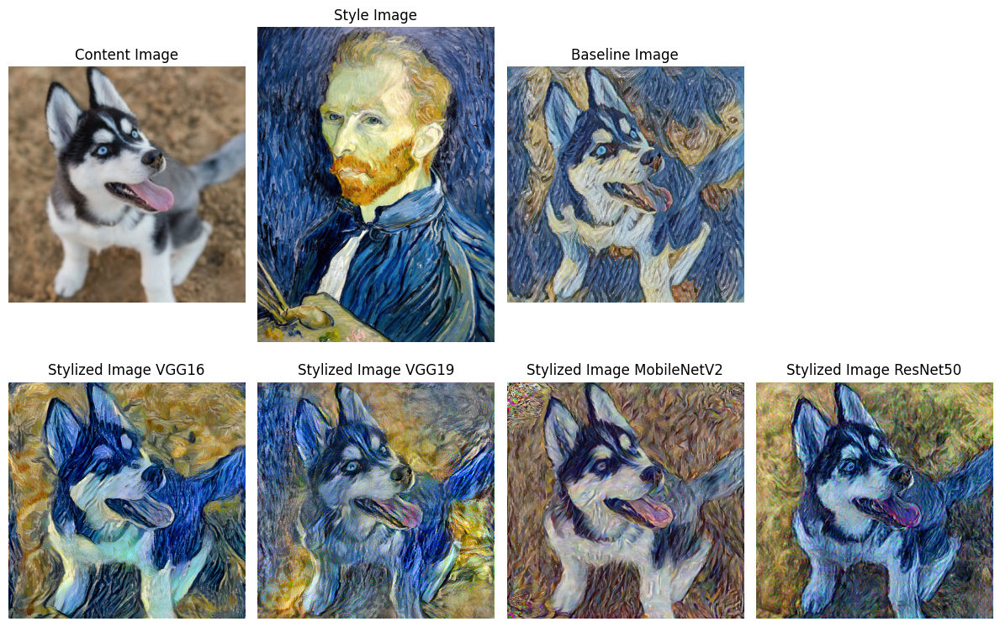

In [ ]:
#definizione dei numeri di epoche e di step di addestramento da svolgere
epochs = 100 #@param #usato per controllare il numero delle epoche di addestramento
steps_per_epoch = 20 #@param  #numero di passi per ogni epoca di addestramento

step = 0 #counter inizializzato a zero per tenere conto del numero totale di step di traning

#definizione delle liste che conterranno le immagini
image_list_mobilenetv2 = []
image_list_vgg19 = []
image_list_vgg16 = []
image_list_resnet50 = []

#definizione delle liste che conterranno le loss del modello VGG19
style_history_vgg19 = []
content_history_vgg19 = []
total_history_vgg19 = []

#definizione delle liste che conterranno le loss del modello VGG16
style_history_vgg16 = []
content_history_vgg16 = []
total_history_vgg16 = []

#definizione delle liste che conterranno le loss del modello MobileNetV2
style_history_mnv2 = []
content_history_mnv2 = []
total_history_mnv2 = []

#definizione delle liste che conterranno le loss del modello ResNet50
style_history_rn50 = []
content_history_rn50 = []
total_history_rn50 = []


#ciclo di addestramento che itera sul numero di epoche specificato
for n in range(epochs):
  print("epoca: ", n)  #stampa il progresso delle epoche
  for m in range(steps_per_epoch):  #ciclo for interno che itera sul numero di step per epoca
      step += 1

      #MobileNetV2
      #viene chiamata la funzione di train che restituisce le tre loss
      style_loss_mnv2, content_loss_mnv2, total_loss_mnv2 = train_step_mobilenetv2(image_mobilenetv2) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      #i valori delle loss vengono convertiti in array NumPy con il metodo .numpy()
      #viene preso l'elemento di indice [0] dell'oggetto, che contiene il valore corrente della loss
      style_loss_val_mnv2 = style_loss_mnv2[0].numpy()
      content_loss_val_mnv2 = content_loss_mnv2[0].numpy()
      total_loss_val_mnv2 = total_loss_mnv2[0].numpy()
      #ogni loss viene aggiunta alla rispettiva history
      style_history_mnv2.append(style_loss_val_mnv2)
      content_history_mnv2.append(content_loss_val_mnv2)
      total_history_mnv2.append(total_loss_val_mnv2)

      #VGG19
      #viene chiamata la funzione di train che restituisce le tre loss
      style_loss_vgg19, content_loss_vgg19, total_loss_vgg19 = train_step_vgg19(image_vgg19) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      #i valori delle loss vengono convertiti in array NumPy con il metodo .numpy()
      #viene preso l'elemento di indice [0] dell'oggetto, che contiene il valore corrente della loss
      style_loss_val_vgg19 = style_loss_vgg19[0].numpy()
      content_loss_val_vgg19 = content_loss_vgg19[0].numpy()
      total_loss_val_vgg19 = total_loss_vgg19[0].numpy()
      #ogni loss viene aggiunta alla rispettiva history
      style_history_vgg19.append(style_loss_val_vgg19)
      content_history_vgg19.append(content_loss_val_vgg19)
      total_history_vgg19.append(total_loss_val_vgg19)

      #VGG16
      #viene chiamata la funzione di train che restituisce le tre loss
      style_loss_vgg16, content_loss_vgg16, total_loss_vgg16 = train_step_vgg16(image_vgg16) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      #i valori delle loss vengono convertiti in array NumPy con il metodo .numpy()
      #viene preso l'elemento di indice [0] dell'oggetto, che contiene il valore corrente della loss
      style_loss_val_vgg16 = style_loss_vgg16[0].numpy()
      content_loss_val_vgg16 = content_loss_vgg16[0].numpy()
      total_loss_val_vgg16 = total_loss_vgg16[0].numpy()
      #ogni loss viene aggiunta alla rispettiva history
      style_history_vgg16.append(style_loss_val_vgg16)
      content_history_vgg16.append(content_loss_val_vgg16)
      total_history_vgg16.append(total_loss_val_vgg16)

      #ResNet50
      #viene chiamata la funzione di train che restituisce le tre loss
      style_loss_rn50, content_loss_rn50, total_loss_rn50 = train_step_resnet50(image_resnet50) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      #i valori delle loss vengono convertiti in array NumPy con il metodo .numpy()
      #viene preso l'elemento di indice [0] dell'oggetto, che contiene il valore corrente della loss
      style_loss_val_rn50 = style_loss_rn50[0].numpy()
      content_loss_val_rn50 = content_loss_rn50[0].numpy()
      total_loss_val_rn50 = total_loss_rn50[0].numpy()
      #ogni loss viene aggiunta alla rispettiva history
      style_history_rn50.append(style_loss_val_rn50)
      content_history_rn50.append(content_loss_val_rn50)
      total_history_rn50.append(total_loss_val_rn50)


  #viene aggiunta l'immagine corrente alla lista delle immagini per ogni modello
  image_list_mobilenetv2.append(image_mobilenetv2.numpy())
  image_list_vgg19.append(image_vgg19.numpy())
  image_list_vgg16.append(image_vgg16.numpy())
  image_list_resnet50.append(image_resnet50.numpy())

  # Pulizia dello schermo e visualizzazione delle immagini
  clear_output(wait = True)
  plt.figure(figsize=(12, 8)) #le imagini hanno una dimensione di 12x12

  # Stampa delle immagini dell'ultima epoca sopra all'immagine stilizzata
  #la funzione subplot() crea un sottoplot nella figura con una griglia di 3 righe e 2 colonne.
  #Il terzo numero rappresenta la posizione del subplot all'interno della griglia
  plt.subplot(2, 4, 1)
  plt.imshow(content_img)
  plt.title("Content Image")
  plt.axis('off') #rimuove gli assi cartesiani per visualizzare meglio l'immagine

  plt.subplot(2, 4, 2)
  plt.imshow(style_img)
  plt.title("Style Image")
  plt.axis('off') #rimuove gli assi cartesiani per visualizzare meglio l'immagine


  plt.subplot(2, 4, 3)
  plt.imshow(baseline)
  plt.title("Baseline Image")
  plt.axis('off') #rimuove gli assi cartesiani per visualizzare meglio l'immagine

  plt.subplot(2, 4, 5)
  #viene preso l'ultimo elemento della lista di immagini e il tensore viene trasformato in un formato compatibile con la visualizzazione dell'immagine
  plt.imshow(tensor_to_image(image_list_vgg16[-1]))
  plt.title("Stylized Image VGG16")
  plt.axis('off') #rimuove gli assi cartesiani per visualizzare meglio l'immagine

  plt.subplot(2, 4, 6)
  #viene preso l'ultimo elemento della lista di immagini e il tensore viene trasformato in un formato compatibile con la visualizzazione dell'immagine
  plt.imshow(tensor_to_image(image_list_vgg19[-1]))
  plt.title("Stylized Image VGG19")
  plt.axis('off') #rimuove gli assi cartesiani per visualizzare meglio l'immagine

  # Stampa delle immagini dello stile e del contenuto sotto una di fianco all'altra
  plt.subplot(2, 4, 7)
  #viene preso l'ultimo elemento della lista di immagini e il tensore viene trasformato in un formato compatibile con la visualizzazione dell'immagine
  plt.imshow(tensor_to_image(image_list_mobilenetv2[-1]))
  plt.title("Stylized Image MobileNetV2")
  plt.axis('off') #rimuove gli assi cartesiani per visualizzare meglio l'immagine

  plt.subplot(2, 4, 8)
  #viene preso l'ultimo elemento della lista di immagini e il tensore viene trasformato in un formato compatibile con la visualizzazione dell'immagine
  plt.imshow(tensor_to_image(image_list_resnet50[-1]))
  plt.title("Stylized Image ResNet50")
  plt.axis('off') #rimuove gli assi cartesiani per visualizzare meglio l'immagine


  plt.tight_layout()#migliora la disposizione dei sottoplot. Evita la sovrapposizioni di etichette degli assi, titoli o altre componenti grafiche.
  plt.show() #visualizza i grafici



###Esempio con pesi invertiti, stile -> contenuto, contenuto -> stile

Come spiegato in precedenza, la fase di scelta dei pesi è una delle fasi più importanti nella progettazione, in quanto influiscono altamente sulla qualità dell'immagine di output. Con l'intenzione di mostrare anche come sarebbero le immagini con dei pesi differenti sia per il contenuto che per lo stile, abbiamo deciso di fornire un esempio in cui questi sono stati invertiti (contenuto -> stile, stile -> contenuto).

In [ ]:
style_weight_resnet50=1e5
content_weight_resnet50=2e5

style_weight_vgg19=1e5
content_weight_vgg19=0.15

style_weight_vgg16=1e6
content_weight_vgg16=1e3

style_weight_mobilenetv2=1e6
content_weight_mobilenetv2=2e9

Una volta cambiati i pesi vengono definite nuovamente le variabili delle immagini e gli ottimizzatori

In [ ]:
image_mobilenetv2_WEIGHT = tf.Variable(content_image)
image_vgg19_WEIGHT = tf.Variable(content_image)
image_vgg16_WEIGHT = tf.Variable(content_image)
image_resnet50_WEIGHT = tf.Variable(content_image)

In [ ]:
opt_vgg19 = tf.keras.optimizers.Adam(learning_rate=0.05, beta_1 = 0.99, epsilon = 1e-1)
opt_ResNet50 = tf.keras.optimizers.Adam(learning_rate=0.1, beta_1 = 0.99, epsilon = 1e-1)
opt_vgg16 = tf.keras.optimizers.Adam(learning_rate=0.01, beta_1 = 0.99, epsilon = 1e-1)
opt_MobileNetV2 = tf.keras.optimizers.Adam(learning_rate=0.02, beta_1 = 0.99, epsilon = 1e-1)

A questo punto viene rieseguito il ciclo di addestramento, uguale a quello precedente ma con i pesi di stile e contenuto diversi. Le immagini generate ottenute ad ogni epoca e le loss ottenute ad ogni step vengono salvate in delle liste, per poter poi visualizzarle e confrontare le prestazioni dei modelli dopo i cambiamenti effettuati.

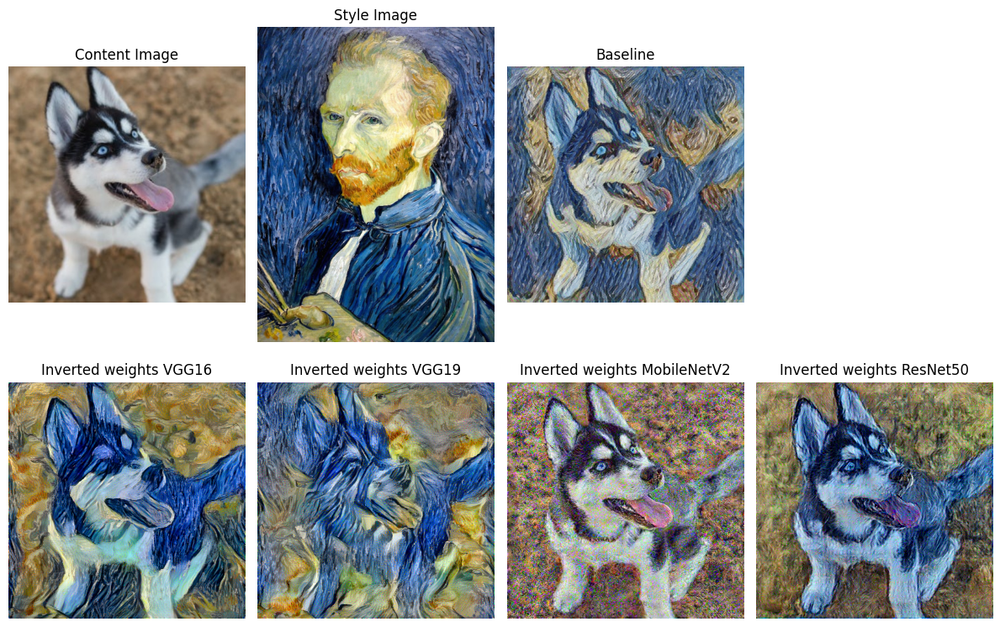

In [ ]:
epochs = 100 #@param #usato per controllare il numero delle epoche di addestramento
steps_per_epoch = 20 #@param  #numero di passi per ogni epoca di addestramento

step = 0 #counter inizializzato a zero per tenere conto del numero totale di step di traning
image_list_mobilenetv2_WEIGHT = []
image_list_vgg19_WEIGHT = []
image_list_vgg16_WEIGHT = []
image_list_resnet50_WEIGHT = []

style_history_vgg19_WEIGHT = []
content_history_vgg19_WEIGHT = []
total_history_vgg19_WEIGHT = []

style_history_vgg16_WEIGHT = []
content_history_vgg16_WEIGHT = []
total_history_vgg16_WEIGHT = []

style_history_mnv2_WEIGHT = []
content_history_mnv2_WEIGHT = []
total_history_mnv2_WEIGHT = []

style_history_rn50_WEIGHT = []
content_history_rn50_WEIGHT = []
total_history_rn50_WEIGHT = []


for n in range(epochs):
  print("epoca: ", n)
  for m in range(steps_per_epoch):
      step += 1

      #MobileNetV2
      style_loss_mnv2_WEIGHT, content_loss_mnv2_WEIGHT, total_loss_mnv2_WEIGHT = train_step_mobilenetv2(image_mobilenetv2_WEIGHT) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      style_loss_val_mnv2_WEIGHT = style_loss_mnv2_WEIGHT[0].numpy()
      content_loss_val_mnv2_WEIGHT = content_loss_mnv2_WEIGHT[0].numpy()
      total_loss_val_mnv2_WEIGHT = total_loss_mnv2_WEIGHT[0].numpy()
      style_history_mnv2_WEIGHT.append(style_loss_val_mnv2_WEIGHT)
      content_history_mnv2_WEIGHT.append(content_loss_val_mnv2_WEIGHT)
      total_history_mnv2_WEIGHT.append(total_loss_val_mnv2_WEIGHT)

      #VGG19
      style_loss_vgg19_WEIGHT, content_loss_vgg19_WEIGHT, total_loss_vgg19_WEIGHT = train_step_vgg19(image_vgg19_WEIGHT) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      style_loss_val_vgg19_WEIGHT = style_loss_vgg19_WEIGHT[0].numpy()
      content_loss_val_vgg19_WEIGHT = content_loss_vgg19_WEIGHT[0].numpy()
      total_loss_val_vgg19_WEIGHT = total_loss_vgg19_WEIGHT[0].numpy()
      style_history_vgg19_WEIGHT.append(style_loss_val_vgg19_WEIGHT)
      content_history_vgg19_WEIGHT.append(content_loss_val_vgg19_WEIGHT)
      total_history_vgg19_WEIGHT.append(total_loss_val_vgg19_WEIGHT)

      #VGG16
      style_loss_vgg16_WEIGHT, content_loss_vgg16_WEIGHT, total_loss_vgg16_WEIGHT = train_step_vgg16(image_vgg16_WEIGHT) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      style_loss_val_vgg16_WEIGHT = style_loss_vgg16_WEIGHT[0].numpy()
      content_loss_val_vgg16_WEIGHT = content_loss_vgg16_WEIGHT[0].numpy()
      total_loss_val_vgg16_WEIGHT = total_loss_vgg16_WEIGHT[0].numpy()
      style_history_vgg16_WEIGHT.append(style_loss_val_vgg16_WEIGHT)
      content_history_vgg16_WEIGHT.append(content_loss_val_vgg16_WEIGHT)
      total_history_vgg16_WEIGHT.append(total_loss_val_vgg16_WEIGHT)

      #ResNet50
      style_loss_rn50_WEIGHT, content_loss_rn50_WEIGHT, total_loss_rn50_WEIGHT = train_step_resnet50(image_resnet50_WEIGHT) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      style_loss_val_rn50_WEIGHT = style_loss_rn50_WEIGHT[0].numpy()
      content_loss_val_rn50_WEIGHT = content_loss_rn50_WEIGHT[0].numpy()
      total_loss_val_rn50_WEIGHT = total_loss_rn50_WEIGHT[0].numpy()
      style_history_rn50_WEIGHT.append(style_loss_val_rn50_WEIGHT)
      content_history_rn50_WEIGHT.append(content_loss_val_rn50_WEIGHT)
      total_history_rn50_WEIGHT.append(total_loss_val_rn50_WEIGHT)


  # Plot delle immagini alla fine di ogni epoca
  image_list_mobilenetv2_WEIGHT.append(image_mobilenetv2_WEIGHT.numpy())  # aggiungi l'immagine corrente alla lista delle immagini
  image_list_vgg19_WEIGHT.append(image_vgg19_WEIGHT.numpy())
  image_list_vgg16_WEIGHT.append(image_vgg16_WEIGHT.numpy())
  image_list_resnet50_WEIGHT.append(image_resnet50_WEIGHT.numpy())

  # Pulizia dello schermo e visualizzazione delle immagini
  clear_output(wait=True)
  plt.figure(figsize=(12, 8))

    # Stampa dell'immagine dell'ultima epoca sopra all'immagine stilizzata
  plt.subplot(2, 4, 1)
  plt.imshow(content_img)
  plt.title("Content Image")
  plt.axis('off')

  plt.subplot(2, 4, 2)
  plt.imshow(style_img)
  plt.title("Style Image")
  plt.axis('off')

  plt.subplot(2, 4, 3)
  plt.imshow(baseline)
  plt.title("Baseline")
  plt.axis('off')

  plt.subplot(2, 4, 5)
  plt.imshow(tensor_to_image(image_list_vgg16_WEIGHT[-1]))
  plt.title("Inverted weights VGG16")
  plt.axis('off')

  plt.subplot(2, 4, 6)
  plt.imshow(tensor_to_image(image_list_vgg19_WEIGHT[-1]))
  plt.title("Inverted weights VGG19")
  plt.axis('off')

  # Stampa delle immagini dello stile e del contenuto sotto una di fianco all'altra
  plt.subplot(2, 4, 7)
  plt.imshow(tensor_to_image(image_list_mobilenetv2_WEIGHT[-1]))
  plt.title("Inverted weights MobileNetV2")
  plt.axis('off')

  plt.subplot(2, 4, 8)
  plt.imshow(tensor_to_image(image_list_resnet50_WEIGHT[-1]))
  plt.title("Inverted weights ResNet50")
  plt.axis('off')


  plt.tight_layout()
  plt.show()

A questo punto viene rieseguito il ciclo di addestramento, uguale a quello precedente ma con i pesi di stile e contenuto diversi. Le immagini generate ottenute ad ogni epoca e le loss ottenute ad ogni step vengono salvate in delle liste, per poter poi visualizzarle e confrontare le prestazioni dei modelli dopo i cambiamenti effettuati.

###Esempio con learning rate differente

Un altro fattore che influenza notevolmente la qualità dell'immagine dell'output è il learning rate. Come spiegato in precedenza, un cambiamento anche piccolo del parametro può causare dei cambiamenti anche significativi del risultato ottenuto.
Per dimostrare questo concetto abbiamo voluto mostrare un esempio dove abbiamo cambiato i learning rate dei quattro modelli. In particolare, i modelli MobileNetV2 e VGG19 presentano dei valori di learning rate superiori rispetto a quelli ottimali, mentre i modelli ResNet50 e VGG16 presentano valori inferiori rispetto a quelli ottimali.

In [ ]:
opt_vgg19 = tf.keras.optimizers.Adam(learning_rate=0.2, beta_1 = 0.99, epsilon = 1e-1)
opt_ResNet50 = tf.keras.optimizers.Adam(learning_rate=0.001, beta_1 = 0.99, epsilon = 1e-1)
opt_vgg16 = tf.keras.optimizers.Adam(learning_rate=0.001, beta_1 = 0.99, epsilon = 1e-1)
opt_MobileNetV2 = tf.keras.optimizers.Adam(learning_rate=0.1, beta_1 = 0.99, epsilon = 1e-1)

Una volta cambiati parametri, vengono ridefinite le variabili delle immagini, ridefiniti i pesi, in quanto sono stati cambiati nell'esempio precedente e viene rieseguita la fase di addestramento.

In [ ]:
image_mobilenetv2_LR = tf.Variable(content_image)
image_vgg19_LR = tf.Variable(content_image)
image_vgg16_LR = tf.Variable(content_image)
image_resnet50_LR = tf.Variable(content_image)

In [ ]:
style_weight_resnet50=2e5
content_weight_resnet50=1e5

style_weight_vgg19=0.15
content_weight_vgg19=1e5

style_weight_vgg16=1e3
content_weight_vgg16=1e6

style_weight_mobilenetv2=2e9
content_weight_mobilenetv2=1e6

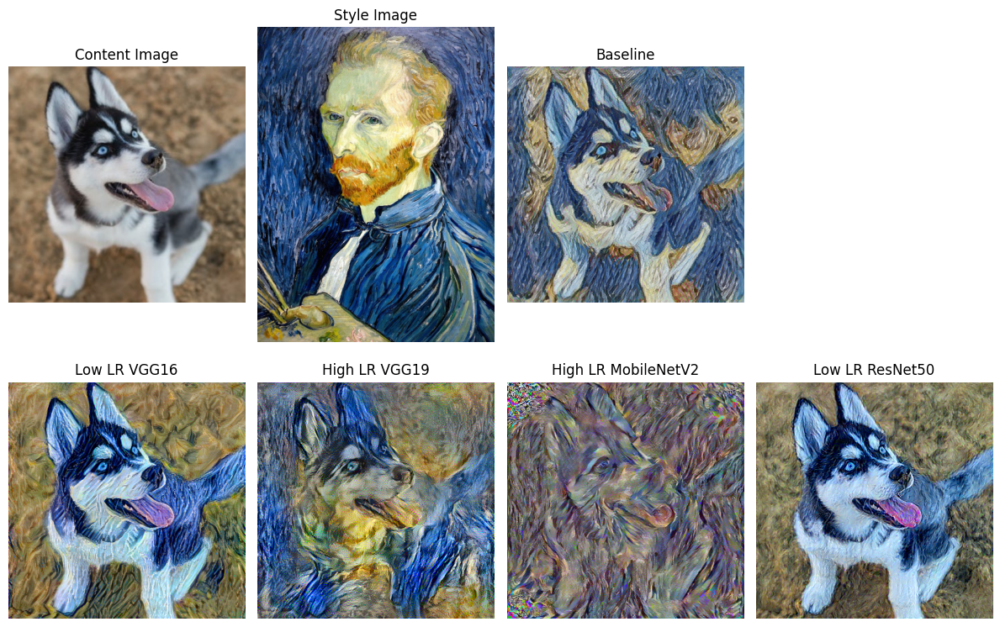

In [ ]:
epochs = 100 #@param #usato per controllare il numero delle epoche di addestramento
steps_per_epoch = 20 #@param  #numero di passi per ogni epoca di addestramento

step = 0 #counter inizializzato a zero per tenere conto del numero totale di step di traning
image_list_mobilenetv2_LR = []
image_list_vgg19_LR = []
image_list_vgg16_LR = []
image_list_resnet50_LR = []

style_history_vgg19_LR = []
content_history_vgg19_LR = []
total_history_vgg19_LR = []

style_history_vgg16_LR = []
content_history_vgg16_LR = []
total_history_vgg16_LR = []

style_history_mnv2_LR = []
content_history_mnv2_LR = []
total_history_mnv2_LR = []

style_history_rn50_LR = []
content_history_rn50_LR = []
total_history_rn50_LR = []


for n in range(epochs):
  print("epoca: ", n)
  for m in range(steps_per_epoch):
      step += 1

      #MobileNetV2
      style_loss_mnv2_LR, content_loss_mnv2_LR, total_loss_mnv2_LR = train_step_mobilenetv2(image_mobilenetv2_LR) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      style_loss_val_mnv2_LR = style_loss_mnv2_LR[0].numpy()
      content_loss_val_mnv2_LR = content_loss_mnv2_LR[0].numpy()
      total_loss_val_mnv2_LR = total_loss_mnv2_LR[0].numpy()
      style_history_mnv2_LR.append(style_loss_val_mnv2_LR)
      content_history_mnv2_LR.append(content_loss_val_mnv2_LR)
      total_history_mnv2_LR.append(total_loss_val_mnv2_LR)

      #VGG19
      style_loss_vgg19_LR, content_loss_vgg19_LR, total_loss_vgg19_LR = train_step_vgg19(image_vgg19_LR) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      style_loss_val_vgg19_LR = style_loss_vgg19_LR[0].numpy()
      content_loss_val_vgg19_LR = content_loss_vgg19_LR[0].numpy()
      total_loss_val_vgg19_LR = total_loss_vgg19_LR[0].numpy()
      style_history_vgg19_LR.append(style_loss_val_vgg19_LR)
      content_history_vgg19_LR.append(content_loss_val_vgg19_LR)
      total_history_vgg19_LR.append(total_loss_val_vgg19_LR)

      #VGG16
      style_loss_vgg16_LR, content_loss_vgg16_LR, total_loss_vgg16_LR = train_step_vgg16(image_vgg16_LR) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      style_loss_val_vgg16_LR = style_loss_vgg16_LR[0].numpy()
      content_loss_val_vgg16_LR = content_loss_vgg16_LR[0].numpy()
      total_loss_val_vgg16_LR = total_loss_vgg16_LR[0].numpy()
      style_history_vgg16_LR.append(style_loss_val_vgg16_LR)
      content_history_vgg16_LR.append(content_loss_val_vgg16_LR)
      total_history_vgg16_LR.append(total_loss_val_vgg16_LR)

      #ResNet50
      style_loss_rn50_LR, content_loss_rn50_LR, total_loss_rn50_LR = train_step_resnet50(image_resnet50_LR) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      style_loss_val_rn50_LR = style_loss_rn50_LR[0].numpy()
      content_loss_val_rn50_LR = content_loss_rn50_LR[0].numpy()
      total_loss_val_rn50_LR = total_loss_rn50_LR[0].numpy()
      style_history_rn50_LR.append(style_loss_val_rn50_LR)
      content_history_rn50_LR.append(content_loss_val_rn50_LR)
      total_history_rn50_LR.append(total_loss_val_rn50_LR)

  # Plot delle immagini alla fine di ogni epoca
  image_list_mobilenetv2_LR.append(image_mobilenetv2_LR.numpy())  # aggiungi l'immagine corrente alla lista delle immagini
  image_list_vgg19_LR.append(image_vgg19_LR.numpy())
  image_list_vgg16_LR.append(image_vgg16_LR.numpy())
  image_list_resnet50_LR.append(image_resnet50_LR.numpy())

  # Pulizia dello schermo e visualizzazione delle immagini
  clear_output(wait=True)
  plt.figure(figsize=(12, 8))

    # Stampa dell'immagine dell'ultima epoca sopra all'immagine stilizzata
  plt.subplot(2, 4, 1)
  plt.imshow(content_img)
  plt.title("Content Image")
  plt.axis('off')

  plt.subplot(2, 4, 2)
  plt.imshow(style_img)
  plt.title("Style Image")
  plt.axis('off')

  plt.subplot(2, 4, 3)
  plt.imshow(baseline)
  plt.title("Baseline")
  plt.axis('off')

  plt.subplot(2, 4, 5)
  plt.imshow(tensor_to_image(image_list_vgg16_LR[-1]))
  plt.title("Low LR VGG16")
  plt.axis('off')

  plt.subplot(2, 4, 6)
  plt.imshow(tensor_to_image(image_list_vgg19_LR[-1]))
  plt.title("High LR VGG19")
  plt.axis('off')

  # Stampa delle immagini dello stile e del contenuto sotto una di fianco all'altra
  plt.subplot(2, 4, 7)
  plt.imshow(tensor_to_image(image_list_mobilenetv2_LR[-1]))
  plt.title("High LR MobileNetV2")
  plt.axis('off')

  plt.subplot(2, 4, 8)
  plt.imshow(tensor_to_image(image_list_resnet50_LR[-1]))
  plt.title("Low LR ResNet50")
  plt.axis('off')


  plt.tight_layout()
  plt.show()

Alla fine dell'addestramento il cambiamento del parametro learning rate riflette ciò che è stato spiegato in precedenza. Nelle immagini generate in cui abbiamo aumentato il valore si nota una profonda perdita di dettagli e un'immagine molto 'sporca'. Nelle immagini in cui il learning rate è stato diminuito invece si nota che, seppur ottenendo un mantenimento dei dettagli, l'applicazione dello stile avviene molto lentamente e servirebbe quindi un numero molto alto di step di addestramento, cosa che andrebbe ad influire negativamente sulle prestazioni dell'esecuzione.

### Esempio con cambiamento del contrasto dell'immagine
Il contrasto di un'immagine influenza la percezione visiva degli oggetti e dei dettagli presenti nell'immagine.
In particolare, se questa ha un contrasto elevato significa che le dettagli delle diverse regioni dell'immagine, come le ombre, le luci, e i confini tra queste regioni, sono più accentuati.

Abbiamo quindi deciso di osservare come queste differenze di contrasto possono influenzare la modalità in cui gli elementi visivi dell'immagine di contenuto vengono estratti e come vengono adattati allo stile dell'immagine di riferimento durante il processo di trasferimento.

Nello specifico abbiamo aumentato il contrasto all'immagine di contenuto, in maniera non eccessiva in modo tale da non perdere dettagli dell'immagine ma accentuarli, così da poter estrarre nuovamente le caratteristiche di stile e contenuto, eseguire un nuovo step di addestramento e osservare infine come si comporta il processo di trasferimento con le modifiche effettuate.

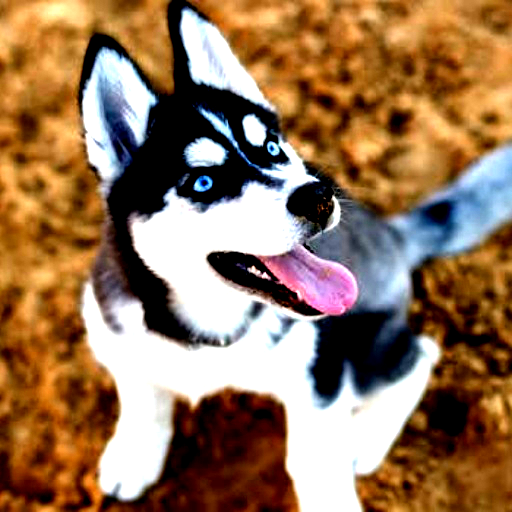

In [ ]:
contrast_image=Image.open("dataset_folder/images/OG/content_image.png")
contrast_enhancer = ImageEnhance.Contrast(contrast_image)
adjusted_image = contrast_enhancer.enhance(3)
CONTENT_IMAGE=("dataset_folder/images/CONTRAST/content_image.png")
adjusted_image.save(CONTENT_IMAGE)
adjusted_image = load_image(CONTENT_IMAGE)
tensor_to_image(adjusted_image)

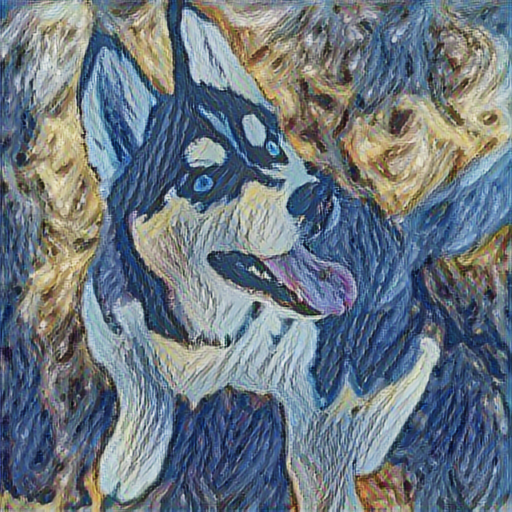

In [ ]:
#le immagini di contenuto e di stile devono essere preparate prima di essere date in pasto al modello attraverso la funzione definita in precedenza load_image
content_image = load_image(CONTENT_IMAGE)
style_image = load_image(STYLE_IMAGE)

hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2') #caricamento del modello scelto per il task di NST
stylized_image = hub_model(tf.constant(content_image), tf.constant(style_image))[0] #vengono date le immagini in input al modello e si salva l'output restituito
baseline = tensor_to_image(stylized_image) #con la funzione definita precedentemente tensor_to_image trasformiamo da tensore a immagine
baseline.save("/content/dataset_folder/images/CONTRAST/baseline.png")
baseline

In [ ]:
#per calcolare la loss avremo bisogno sia dei target dello stile sia quelli del contenuto
#ad ogni extractor viene passato il nome del modello che dovrà utilizzare

style_targets_mobilenetv2 = extractor_mobilenetv2(style_image, "MobileNetV2")['style']
content_targets_mobilenetv2 = extractor_mobilenetv2(content_image, "MobileNetV2")['content']

style_targets_vgg19 = extractor_vgg19(style_image, "VGG19")['style']
content_targets_vgg19 = extractor_vgg19(content_image, "VGG19")['content']

style_targets_vgg16 = extractor_vgg16(style_image, "VGG16")['style']
content_targets_vgg16 = extractor_vgg16(content_image, "VGG16")['content']

style_targets_resnet50 = extractor_resnet50(style_image, "ResNet50")['style']
content_targets_resnet50 = extractor_resnet50(content_image, "ResNet50")['content']

In [ ]:
image_mobilenetv2_CONTRAST = tf.Variable(content_image)
image_vgg19_CONTRAST = tf.Variable(content_image)
image_vgg16_CONTRAST = tf.Variable(content_image)
image_resnet50_CONTRAST = tf.Variable(content_image)

In [ ]:
style_weight_resnet50=2e6
content_weight_resnet50=1e5

style_weight_vgg19=0.15
content_weight_vgg19=1e5

style_weight_vgg16=1e3
content_weight_vgg16=1e6

style_weight_mobilenetv2=2e9
content_weight_mobilenetv2=1e6

In [ ]:
opt_vgg19 = tf.keras.optimizers.Adam(learning_rate=0.05, beta_1 = 0.99, epsilon = 1e-1)
opt_ResNet50 = tf.keras.optimizers.Adam(learning_rate=0.1, beta_1 = 0.99, epsilon = 1e-1)
opt_vgg16 = tf.keras.optimizers.Adam(learning_rate=0.01, beta_1 = 0.99, epsilon = 1e-1)
opt_MobileNetV2 = tf.keras.optimizers.Adam(learning_rate=0.02, beta_1 = 0.99, epsilon = 1e-1)

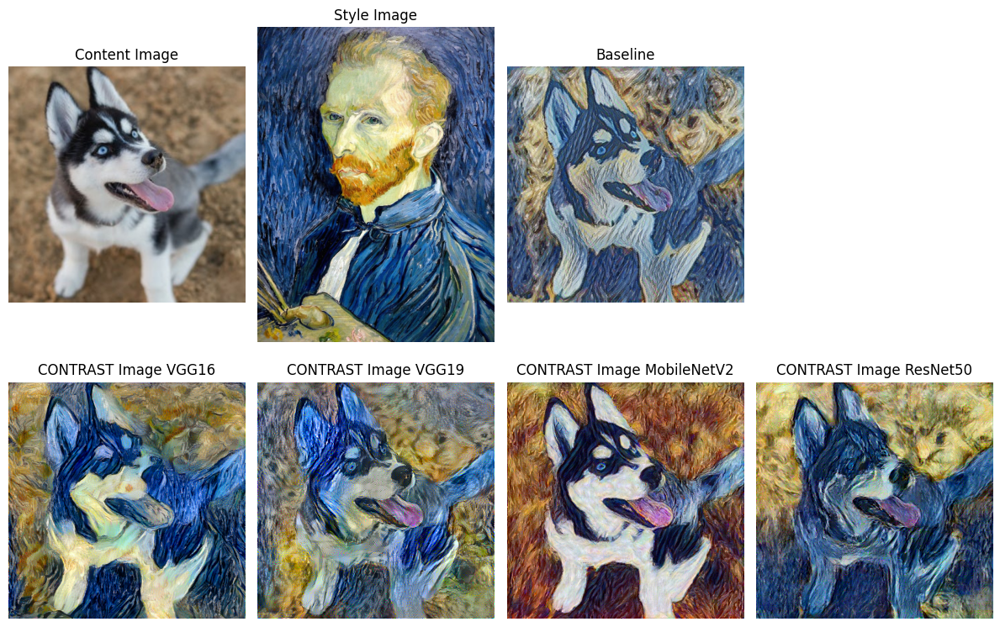

In [ ]:
epochs = 100 #@param #usato per controllare il numero delle epoche di addestramento
steps_per_epoch = 20 #@param  #numero di passi per ogni epoca di addestramento

step = 0 #counter inizializzato a zero per tenere conto del numero totale di step di traning
image_list_mobilenetv2_CONTRAST = []
image_list_vgg19_CONTRAST = []
image_list_vgg16_CONTRAST = []
image_list_resnet50_CONTRAST = []

style_history_vgg19_CONTRAST = []
content_history_vgg19_CONTRAST = []
total_history_vgg19_CONTRAST = []

style_history_vgg16_CONTRAST = []
content_history_vgg16_CONTRAST = []
total_history_vgg16_CONTRAST = []

style_history_mnv2_CONTRAST = []
content_history_mnv2_CONTRAST = []
total_history_mnv2_CONTRAST = []

style_history_rn50_CONTRAST = []
content_history_rn50_CONTRAST = []
total_history_rn50_CONTRAST = []


for n in range(epochs):
  print("epoca: ", n)
  for m in range(steps_per_epoch):
      step += 1

      #MobileNetV2
      style_loss_mnv2_CONTRAST, content_loss_mnv2_CONTRAST, total_loss_mnv2_CONTRAST = train_step_mobilenetv2(image_mobilenetv2_CONTRAST) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      style_loss_val_mnv2_CONTRAST = style_loss_mnv2_CONTRAST[0].numpy()
      content_loss_val_mnv2_CONTRAST = content_loss_mnv2_CONTRAST[0].numpy()
      total_loss_val_mnv2_CONTRAST = total_loss_mnv2_CONTRAST[0].numpy()
      style_history_mnv2_CONTRAST.append(style_loss_val_mnv2_CONTRAST)
      content_history_mnv2_CONTRAST.append(content_loss_val_mnv2_CONTRAST)
      total_history_mnv2_CONTRAST.append(total_loss_val_mnv2_CONTRAST)

      #VGG19
      style_loss_vgg19_CONTRAST, content_loss_vgg19_CONTRAST, total_loss_vgg19_CONTRAST = train_step_vgg19(image_vgg19_CONTRAST) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      style_loss_val_vgg19_CONTRAST = style_loss_vgg19_CONTRAST[0].numpy()
      content_loss_val_vgg19_CONTRAST = content_loss_vgg19_CONTRAST[0].numpy()
      total_loss_val_vgg19_CONTRAST = total_loss_vgg19_CONTRAST[0].numpy()
      style_history_vgg19_CONTRAST.append(style_loss_val_vgg19_CONTRAST)
      content_history_vgg19_CONTRAST.append(content_loss_val_vgg19_CONTRAST)
      total_history_vgg19_CONTRAST.append(total_loss_val_vgg19_CONTRAST)

      #VGG16
      style_loss_vgg16_CONTRAST, content_loss_vgg16_CONTRAST, total_loss_vgg16_CONTRAST = train_step_vgg16(image_vgg16_CONTRAST) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      style_loss_val_vgg16_CONTRAST = style_loss_vgg16_CONTRAST[0].numpy()
      content_loss_val_vgg16_CONTRAST = content_loss_vgg16_CONTRAST[0].numpy()
      total_loss_val_vgg16_CONTRAST = total_loss_vgg16_CONTRAST[0].numpy()
      style_history_vgg16_CONTRAST.append(style_loss_val_vgg16_CONTRAST)
      content_history_vgg16_CONTRAST.append(content_loss_val_vgg16_CONTRAST)
      total_history_vgg16_CONTRAST.append(total_loss_val_vgg16_CONTRAST)

      #ResNet50
      style_loss_rn50_CONTRAST, content_loss_rn50_CONTRAST, total_loss_rn50_CONTRAST = train_step_resnet50(image_resnet50_CONTRAST) #ogni iterazione del for viene chiamato il train_step sull'immagine per un singolo passo di addestramento
      style_loss_val_rn50_CONTRAST = style_loss_rn50_CONTRAST[0].numpy()
      content_loss_val_rn50_CONTRAST = content_loss_rn50_CONTRAST[0].numpy()
      total_loss_val_rn50_CONTRAST = total_loss_rn50_CONTRAST[0].numpy()
      style_history_rn50_CONTRAST.append(style_loss_val_rn50_CONTRAST)
      content_history_rn50_CONTRAST.append(content_loss_val_rn50_CONTRAST)
      total_history_rn50_CONTRAST.append(total_loss_val_rn50_CONTRAST)

  # Plot delle immagini alla fine di ogni epoca
  image_list_mobilenetv2_CONTRAST.append(image_mobilenetv2_CONTRAST.numpy())  # aggiungi l'immagine corrente alla lista delle immagini
  image_list_vgg19_CONTRAST.append(image_vgg19_CONTRAST.numpy())
  image_list_vgg16_CONTRAST.append(image_vgg16_CONTRAST.numpy())
  image_list_resnet50_CONTRAST.append(image_resnet50_CONTRAST.numpy())

  # Pulizia dello schermo e visualizzazione delle immagini
  clear_output(wait=True)
  plt.figure(figsize=(12, 8))

    # Stampa dell'immagine dell'ultima epoca sopra all'immagine stilizzata
  plt.subplot(2, 4, 1)
  plt.imshow(content_img)
  plt.title("Content Image")
  plt.axis('off')

  plt.subplot(2, 4, 2)
  plt.imshow(style_img)
  plt.title("Style Image")
  plt.axis('off')

  plt.subplot(2, 4, 3)
  plt.imshow(baseline)
  plt.title("Baseline")
  plt.axis('off')

  plt.subplot(2, 4, 5)
  plt.imshow(tensor_to_image(image_list_vgg16_CONTRAST[-1]))
  plt.title("CONTRAST Image VGG16")
  plt.axis('off')

  plt.subplot(2, 4, 6)
  plt.imshow(tensor_to_image(image_list_vgg19_CONTRAST[-1]))
  plt.title("CONTRAST Image VGG19")
  plt.axis('off')

  # Stampa delle immagini dello stile e del contenuto sotto una di fianco all'altra
  plt.subplot(2, 4, 7)
  plt.imshow(tensor_to_image(image_list_mobilenetv2_CONTRAST[-1]))
  plt.title("CONTRAST Image MobileNetV2")
  plt.axis('off')

  plt.subplot(2, 4, 8)
  plt.imshow(tensor_to_image(image_list_resnet50_CONTRAST[-1]))
  plt.title("CONTRAST Image ResNet50")
  plt.axis('off')


  plt.tight_layout()
  plt.show()

## Qualità delle immmagini generate
Come ultimo task abbiamo voluto approfondire la qualità delle immagini generata, ovvero quanto esse sono 'simili' alle immagini da cui sono stati estratti stile e contenuto, e ci siamo avvalsi principalmente di due metriche di seguito spiegate.


###Qualità dello stile
All'interno della pubblicazione Evaluate and Improve the Quality of Neural Style Transfer, sono presenti dei modi per valutare la qualità di un'immagine generata. Tra questi, spicca il calcolo dei Global Effects. Questi si riferiscono agli effetti di stile che influenzano l'immagine generata.
Tra i diversi tipi di Global Effects possibli (tonalità dell'immagine, presenza di pattern o textures specifiche, la luminosità...), abbiamo deciso di osservare la distribuzione dei colori.

Per fare ciò abbiamo calcolato la matrice di correlazione tra gli istogrammi delle immagini generate. In particolare, questi forniscono informazioni sulla distribuzione dei valori di pixel per ciascun canale di colore (rosso, verde, blu). Abbiamo raggruppato in base al modello gli istogrammi delle immagini generate, valutando la correlazione con l'immagine di stile.


- Un valore di 1 indica una correlazione perfetta tra due istogrammi, il che significa che i due istogrammi hanno la stessa distribuzione di valori. Ciò indica una forte correlazione positiva tra i canali di colore delle immagini.
- Un valore di -1 indica una correlazione perfetta inversa tra due istogrammi, il che significa che i due istogrammi hanno distribuzioni di valori completamente opposte. Ciò indica una forte correlazione negativa tra i canali di colore delle immagini.
- Un valore di 0 indica una mancanza di correlazione tra due istogrammi, il che significa che i due istogrammi non hanno una relazione lineare tra di loro. Ciò indica una mancanza di correlazione tra i canali di colore delle immagini.

Da notare che per valutare al meglio la qualità dell'immagine generata non basta solamente calcolare un Global Effect come in questo caso ma servirebbe un calcolo di più metriche e metterle a confronto. Per questioni di tempo abbiamo però deciso di studiare solamente una tecnica.



VGG16

In [ ]:
#l'immagine di stile viene caricata e trasformata in un array numpy
style = Image.open(STYLE_IMAGE)
style_arr = np.array(style)

#i tensori di immagini ottenute vengono trasformati in array numpy
tfhub_arr = stylized_image.numpy()
vgg16_weight = image_vgg16_WEIGHT.numpy()
vgg16_contrast = image_vgg16_CONTRAST.numpy()
vgg16_lr = image_vgg16_LR.numpy()
vgg16_og = image_vgg16.numpy()


# Vengono calcolati gli istogrammi per i canali di colore dell'immagine stilizzata
#bins = intervalli o sottoinsiemi in cui viene suddiviso l'intervallo dei valori dell'istogramma
#[..., i] Seleziona il canale di colore i dell'immagine stilizzata originale. L'operatore ... indica di selezionare tutti gli indici degli altri assi dell'array.
#.ravel() =  restituisce un array monodimensionale che contiene tutti gli elementi dell'array di input.
#[0] = seleziona il primo elemento del risultato della funzione np.histogram(), che rappresenta i conteggi dei valori nei bin.
#range() = intervallo dei valori dell'istogramma. L'istogramma 'style_hist' presenta un range diverso rispetto agli altri perchè gli altri array sono stati precedentemente scalati con la funzione clip_0_1()
tfhub_hist = [np.histogram(tfhub_arr[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
style_hist = [np.histogram(style_arr[..., i].ravel(), bins=256, range=(0, 256))[0] for i in range(3)]
vgg16_hist_og = [np.histogram(vgg16_og[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
vgg16_hist_contrast = [np.histogram(vgg16_contrast[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
vgg16_hist_lr = [np.histogram(vgg16_lr[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
vgg16_hist_weight = [np.histogram(vgg16_weight[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]

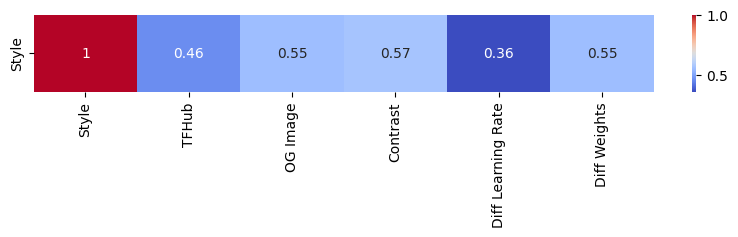

In [ ]:
# Lista dei nomi dei modelli
examples_names = ['Style', 'TFHub', 'OG Image', 'Contrast', 'Diff Learning Rate', 'Diff Weights']

# Lista degli istogrammi
histograms = [style_hist, tfhub_hist, vgg16_hist_og, vgg16_hist_contrast, vgg16_hist_lr, vgg16_hist_weight ]

# Calcola la matrice di correlazione per tutti i canali
correlation_matrix = np.corrcoef([np.concatenate(hist) for hist in histograms])

# Crea un DataFrame pandas
df = pd.DataFrame(correlation_matrix, index=examples_names, columns=examples_names)

# Selezioniamo solo la prima riga del DataFrame
first_row = df.iloc[0:1, :]

# Creiamo la heatmap
plt.figure(figsize=(10, 1))  # Imposta le dimensioni del grafico
sns.heatmap(first_row, annot=True, cmap='coolwarm', cbar=True, xticklabels=True, yticklabels=True)
plt.savefig('dataset_folder/images/OG/ValuationHEATMAP.png', dpi=300) #il plot viene salvato nel percorso specificato
plt.show()

La Heat Map sopra indicata rappresenta la correlazione della distribuzione dei colori tra l'immagine di stile e tutte le immagini che sono state generate dal modello VGG16. Ogni immagine è diversa dalle altre o per il cambiamento di alcuni parametri, oppure per la modifica dell'immagine di contenuto. Come si può notare subito, le immagini generate che hanno una maggiore correlazione con l'immagine di stile sono l'immagine con i pesi ottimizzati, quella con contrasto elevato e quella con i pesi invertiti. Se si vanno a vedere anche visivamente le immagini generate da questo modello, il valore alto di correlazione per i canali colore è giustificato in quanto VGG16 prende molto bene dall'immagine di stile oltre che i pattern e le textures anche i colori a differenza di altri modelli preaddestrati utilizzati.
Perciò possiamo dire che dal punto di vista della distribuzione dei colori il modello VGG16 si comporta in maniera abbastanza buona in tutti gli esempi mostrati. Ripetiamo però che per valutare al meglio e in modo completo la qualità dello stile di un'immagine generata con NST non basta calcolare solo questa metrica, essa si sofferema soltanto su un aspetto dello stile ignorando totalmente altri aspetti come i pattern e le texture acquisite.

Oltre le immagini generate da VGG16 è presente anche la correlazione tra l'immagine di stile e l'immagine generata dalla baseline (Tf-Hub). Nel caso dell'esempio in questione il modello preaddestrato di Tf-Hub ha una buona capacità di generalizzazione e mantiene in modo accettabile una cerca correlazione con la distribuzione dei colori dell'immagine di stile. Ciò non è sempre così, abbiamo notato diversi esempi provando a cambiare l'immagine di stile (lasciando sempre lo stesso artista ma cambiando opera) la correlazione era tendente allo zero e perciò pressoché nulla.

Da notare che le metriche di valutazione per ogni modello preaddestrato i valori trovati cambiano molto a seconda dell'immagine scelta sia per lo stile che per il contenuto. Perciò si deve tenere conto che le considerazioni fatte fanno riferimento esclusivamente alle due immagini scelte nell'ultima esecuzione del notebook.

VGG19

In [ ]:
#l'immagine di stile viene caricata e trasformata in un array numpy
style = Image.open(STYLE_IMAGE)
style_arr = np.array(style)

#i tensori di immagini ottenute vengono trasformati in array numpy
tfhub_arr = stylized_image.numpy()
vgg19_weight = image_vgg19_WEIGHT.numpy()
vgg19_contrast = image_vgg19_CONTRAST.numpy()
vgg19_lr = image_vgg19_LR.numpy()
vgg19_og = image_vgg19.numpy()

# Vengono calcolati gli istogrammi per i canali di colore dell'immagine stilizzata
#bins = intervalli o sottoinsiemi in cui viene suddiviso l'intervallo dei valori dell'istogramma
#[..., i] Seleziona il canale di colore i dell'immagine stilizzata originale. L'operatore ... indica di selezionare tutti gli indici degli altri assi dell'array.
#.ravel() =  restituisce un array monodimensionale che contiene tutti gli elementi dell'array di input.
#[0] = seleziona il primo elemento del risultato della funzione np.histogram(), che rappresenta i conteggi dei valori nei bin.
#range() = intervallo dei valori dell'istogramma. L'istogramma 'style_hist' presenta un range diverso rispetto agli altri perchè gli altri array sono stati precedentemente scalati con la funzione clip_0_1()
tfhub_hist = [np.histogram(tfhub_arr[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
style_hist = [np.histogram(style_arr[..., i].ravel(), bins=256, range=(0, 256))[0] for i in range(3)]
vgg19_hist_og = [np.histogram(vgg19_og[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
vgg19_hist_contrast = [np.histogram(vgg19_contrast[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
vgg19_hist_lr = [np.histogram(vgg19_lr[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
vgg19_hist_weight = [np.histogram(vgg19_weight[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]

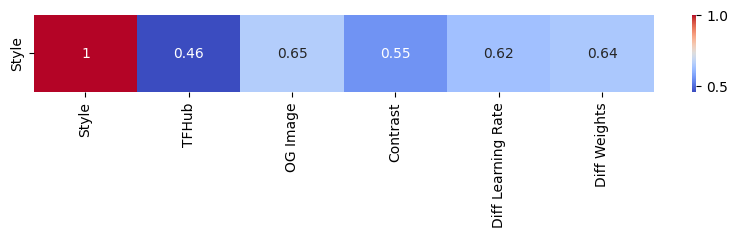

In [ ]:
# Lista dei nomi dei modelli
examples_names = ['Style', 'TFHub', 'OG Image', 'Contrast', 'Diff Learning Rate', 'Diff Weights']

# Lista degli istogrammi
histograms = [style_hist, tfhub_hist, vgg19_hist_og, vgg19_hist_contrast, vgg19_hist_lr, vgg19_hist_weight ]

# Calcola la matrice di correlazione per tutti i canali
correlation_matrix = np.corrcoef([np.concatenate(hist) for hist in histograms])

# Crea un DataFrame pandas
df = pd.DataFrame(correlation_matrix, index=examples_names, columns=examples_names)

# Selezioniamo solo la prima riga del DataFrame
first_row = df.iloc[0:1, :]

# Creiamo la heatmap
plt.figure(figsize=(10, 1))  # Imposta le dimensioni del grafico
sns.heatmap(first_row, annot=True, cmap='coolwarm', cbar=True, xticklabels=True, yticklabels=True)
plt.savefig('dataset_folder/images/OG/ValuationHEATMAP.png', dpi=300)
plt.show()

Osservando la heatmap del modello vgg19 riferito a questa specifica immagine si puo osservare che l'immagine originale arriva al risultato migliore, anche se si avvicinano molto anche l'immagine con un differente learning rate e l'immagine con i pesi invertiti. Per quanto riguarda le buone prestazioni date dall'immagine con il lr modificato sono giustificate dal fatto che quest'ultimo sia stato aumentato migliorando quindi l'estrazione dei dettagli di stile (in questo caso i colori). Il risultato ottenuto non è però ottimale dal punto di vista grafico, in quanto l'immagine generata presenta tratti molto forti e poco
distinguibili visivamente.
Le altre due immagini generate dal modello VGG19 presentano un indice di correlazione non tanto differente rispetto al valore dell'immagine appena descritta, ma dal punto di vista visivo si può notare un miglior bilanciamento tra stile e contenuto.

Talvolta i valori delle immagini generate con VGG16 e VGG19 presentano valori della metrica simili, tuttavia non sempre è il caso come questo. Ciò è un'altra conferma del fatto che i valori delle metriche cambino tantissimo al cambiamento delle immagini addestrate a prescidenre dai modelli utilizzati e dai parametri modificati. Ciò che cambia meno drasticamente è il feedback visivo delle immagini generate.

MobileNetV2

In [ ]:
#l'immagine di stile viene caricata e trasformata in un array numpy
style = Image.open(STYLE_IMAGE)
style_arr = np.array(style)

#i tensori di immagini ottenute vengono trasformati in array numpy
tfhub_arr = stylized_image.numpy()
mobilenetv2_weight = image_mobilenetv2_WEIGHT.numpy()
mobilenetv2_contrast = image_mobilenetv2_CONTRAST.numpy()
mobilenetv2_lr = image_mobilenetv2_LR.numpy()
mobilenetv2_og = image_mobilenetv2.numpy()

# Vengono calcolati gli istogrammi per i canali di colore dell'immagine stilizzata
#bins = intervalli o sottoinsiemi in cui viene suddiviso l'intervallo dei valori dell'istogramma
#[..., i] Seleziona il canale di colore i dell'immagine stilizzata originale. L'operatore ... indica di selezionare tutti gli indici degli altri assi dell'array.
#.ravel() =  restituisce un array monodimensionale che contiene tutti gli elementi dell'array di input.
#[0] = seleziona il primo elemento del risultato della funzione np.histogram(), che rappresenta i conteggi dei valori nei bin.
#range() = intervallo dei valori dell'istogramma. L'istogramma 'style_hist' presenta un range diverso rispetto agli altri perchè gli altri array sono stati precedentemente scalati con la funzione clip_0_1()
tfhub_hist = [np.histogram(tfhub_arr[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
style_hist = [np.histogram(style_arr[..., i].ravel(), bins=256, range=(0, 256))[0] for i in range(3)]
mobilenetv2_hist_og = [np.histogram(mobilenetv2_og[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
mobilenetv2_hist_contrast = [np.histogram(mobilenetv2_contrast[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
mobilenetv2_hist_lr = [np.histogram(mobilenetv2_lr[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
mobilenetv2_hist_weight = [np.histogram(mobilenetv2_weight[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]

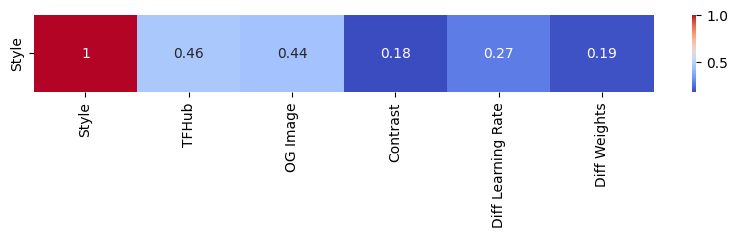

In [ ]:
# Lista dei nomi dei modelli
examples_names = ['Style', 'TFHub', 'OG Image', 'Contrast', 'Diff Learning Rate', 'Diff Weights']

# Lista degli istogrammi
histograms = [style_hist, tfhub_hist, mobilenetv2_hist_og, mobilenetv2_hist_contrast, mobilenetv2_hist_lr, mobilenetv2_hist_weight ]

# Calcola la matrice di correlazione per tutti i canali
correlation_matrix = np.corrcoef([np.concatenate(hist) for hist in histograms])

# Crea un DataFrame pandas
df = pd.DataFrame(correlation_matrix, index=examples_names, columns=examples_names)

# Selezioniamo solo la prima riga del DataFrame
first_row = df.iloc[0:1, :]

# Creiamo la heatmap
plt.figure(figsize=(10, 1))  # Imposta le dimensioni del grafico
sns.heatmap(first_row, annot=True, cmap='coolwarm', cbar=True, xticklabels=True, yticklabels=True)
plt.savefig('dataset_folder/images/OG/ValuationHEATMAP.png', dpi=300)
plt.show()

Durante lo sviluppo del progetto e risultato evidente, prima visivamente poi dal calcolo di questa metrica, che il modello preaddestrato MobileNetV2 non fosse il migliore per estrapolare i colori dell'immagine di stile ma fosse invece abbastanza buono per quanto riguarda i pattern e le textures. Diciamo che per quanto riguarda le immagini generate da questo modello è evidente che l'ottimizzazione fatta per la scelta dei pesi e del learning rate ha dato i suoi frutti permettendo di avere una correlazione tra immagine di stile e OG Image molto più alta rispetto agli altri esempi che sono stati svolti sullo stesso modello preaddestrato.

ResNet50

In [ ]:
#l'immagine di stile viene caricata e trasformata in un array numpy
style = Image.open(STYLE_IMAGE)
style_arr = np.array(style)

#i tensori di immagini ottenute vengono trasformati in array numpy
tfhub_arr = stylized_image.numpy()
resnet50_weight = image_resnet50_WEIGHT.numpy()
resnet50_contrast = image_resnet50_CONTRAST.numpy()
resnet50_lr = image_resnet50_LR.numpy()
resnet50_og = image_resnet50.numpy()

# Vengono calcolati gli istogrammi per i canali di colore dell'immagine stilizzata
#bins = intervalli o sottoinsiemi in cui viene suddiviso l'intervallo dei valori dell'istogramma
#[..., i] Seleziona il canale di colore i dell'immagine stilizzata originale. L'operatore ... indica di selezionare tutti gli indici degli altri assi dell'array.
#.ravel() =  restituisce un array monodimensionale che contiene tutti gli elementi dell'array di input.
#[0] = seleziona il primo elemento del risultato della funzione np.histogram(), che rappresenta i conteggi dei valori nei bin.
#range() = intervallo dei valori dell'istogramma. L'istogramma 'style_hist' presenta un range diverso rispetto agli altri perchè gli altri array sono stati precedentemente scalati con la funzione clip_0_1()
tfhub_hist = [np.histogram(tfhub_arr[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
style_hist = [np.histogram(style_arr[..., i].ravel(), bins=256, range=(0, 256))[0] for i in range(3)]
resnet50_hist_og = [np.histogram(resnet50_og[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
resnet50_hist_contrast = [np.histogram(resnet50_contrast[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
resnet50_hist_lr = [np.histogram(resnet50_lr[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]
resnet50_hist_weight = [np.histogram(resnet50_weight[..., i].ravel(), bins=256, range=(0, 1))[0] for i in range(3)]

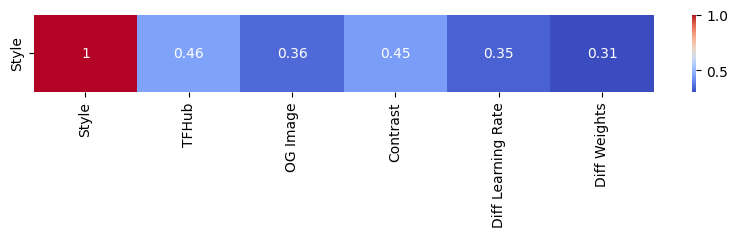

In [ ]:
# Lista dei nomi dei modelli
examples_names = ['Style', 'TFHub', 'OG Image', 'Contrast', 'Diff Learning Rate', 'Diff Weights']

# Lista degli istogrammi
histograms = [style_hist, tfhub_hist, resnet50_hist_og, resnet50_hist_contrast, resnet50_hist_lr, resnet50_hist_weight ]

# Calcola la matrice di correlazione per tutti i canali
correlation_matrix = np.corrcoef([np.concatenate(hist) for hist in histograms])

# Crea un DataFrame pandas
df = pd.DataFrame(correlation_matrix, index=examples_names, columns=examples_names)

# Selezioniamo solo la prima riga del DataFrame
first_row = df.iloc[0:1, :]

# Creiamo la heatmap
plt.figure(figsize=(10, 1))  # Imposta le dimensioni del grafico
sns.heatmap(first_row, annot=True, cmap='coolwarm', cbar=True, xticklabels=True, yticklabels=True)
plt.savefig('dataset_folder/images/OG/ValuationHEATMAP.png', dpi=300)
plt.show()

Il vettore soprastante rappresenta una heat map contenente i valori di correlazione (della distribuzione dei colori) delle immagini generate con il modello ResNet50 rispetto all'immagine di stile. Come si può notare il modello ResNet50 (Da specificare per le due immagini in input) si comporta in modo simile per tutti gli esempi eccetto che per quanto riguarda il l'esempio in cui il contrasto viene aumentato. In questo caso l'immagine con un alto valore di correlazione della distribuzione dei colori non è la migliore visivamente parlando. Per quanto riguarda ResNet50 c'è una maggiore differenza (in positivo) tra l'immegine con il contrasto alto e gli altri esempi.

### Qualità del contenuto
Come metrica per valutare la qualità di un'immagine generata rispetto all'immagine di contenuto abbimao scelto il PSNR (Peak Signal Noise Ratio).  Questo quantifica la differenza tra due immagini basandosi sulla distorsione media al quadrato tra i valori dei pixel. Il PSNR viene calcolato utilizzando una formula matematica che confronta l'immagine originale con l'immagine compressa o elaborata.

Un PSNR alto indica una minore differenza tra le due immagini e quindi una maggiore 'qualità' dell'immagine generata rispetto a quella di riferimento. Tuttavia nel contesto del NST l'obiettivo non è il riprodurre l'immagine di contenuto il più fedelmente possibile, ma creare una nuova immagine che combini il contenuto dell'immagine originale con lo stile dell'immagine di stile. Perciò, un PSNR alto potrebbe non necessariamente corrispondere ad un buon risultato, poichè si potrebbe trattare di un'immagine generate che è molto simile all'immagine di contenuto ma che non ha catturato adeguatamente lo stile dall'immagine di riferimento.

In conclusione, come detto anche per la metrica di valutazione dello stile, il PSNR da solo non è sufficiente per valutare al meglio la qualità dell'immagine generata. Per farlo al meglio si dovrebbero fare delle considerazioni facendo riferimento anche ad altre metriche che prendano in considerazione dello stile e la percezione visiva dell'immagine generata.

VGG16

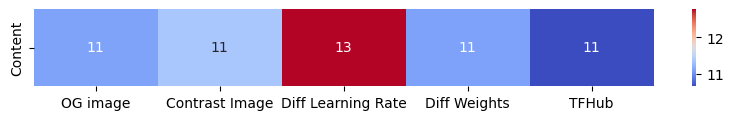

In [ ]:
#viene aperta l'immagine di contenuto e convertita in un array numpy
content = Image.open(CONTENT_IMAGE)
content = np.array(content)
#viene espanso l'asse dell'array in modo che abbia una dimensione di batch
content = np.expand_dims(content, axis=0)
#vengono normalizzati i valori dell'array nell'intervallo [0, 1]
content = img_as_float(content)

#le immagini di output vengono convertite da tensori numpy in float
#La conversione serve per evitare problemi di saturazione o perdita di precisione durante il calcolo del PSNR
tfhub_content = img_as_float(stylized_image.numpy())
vgg16_content_og = img_as_float(image_vgg16.numpy())
vgg16_content_contrast = img_as_float(image_vgg16_CONTRAST.numpy())
vgg16_content_lr = img_as_float(image_vgg16_LR.numpy())
vgg16_content_weights = img_as_float(image_vgg16_WEIGHT.numpy())

#a questo punto viene calcolato il psnr traogni immagine e quella di contenuto
#data_range rappresenta l'intervallo massimo possibile per i valori dei pixel nelle immagini.
psnr_value_vgg16_og = psnr(content, vgg16_content_og, data_range = 1.0)
psnr_value_vgg16_contrast = psnr(content, vgg16_content_contrast, data_range = 1.0)
psnr_value_vgg16_lr = psnr(content, vgg16_content_lr, data_range = 1.0)
psnr_value_vgg16_weights = psnr(content, vgg16_content_weights, data_range = 1.0)
psnr_value_baseline = psnr(content, tfhub_content , data_range = 1.0)

#viene creato un dataframe, in cui si hanno i nomi dei modelli come colonne e il valore psnr delle immagini di contenuto come unica riga
data = {
    'OG image': [psnr_value_vgg16_og],
    'Contrast Image': [psnr_value_vgg16_contrast],
    'Diff Learning Rate': [psnr_value_vgg16_lr],
    'Diff Weights': [psnr_value_vgg16_weights],
    'TFHub': [psnr_value_baseline]
}
df = pd.DataFrame(data, index=['Content'])

#viene selezionata solo la prima riga del DataFrame
first_row = df.iloc[0:1, :]

#viene creata la heatmap
plt.figure(figsize=(10, 1))  # Imposta le dimensioni del grafico
sns.heatmap(first_row, annot=True, cmap='coolwarm', cbar=True, xticklabels=True, yticklabels=True)
plt.savefig('dataset_folder/images/OG/ValuationHEATMAP.png', dpi=300) #viene salvata la heatmap nel percorso specificato
plt.show()

Per quanto riguarda la qualità del mantenimento del contenuto per il modello VGG tutti gli esempi (in questo caso) mantengono abbastanza bene il contenuto dell'immagine originale, spicca tra gli esempi quello con un learning rate differente (più precisamente basso) ciò conferma la tesi che avendo un learning rate molto basso il modello tende a mantenere i contorni con linee più nette portando quindi ad un miglior mantenimento dell'imamgine di contenuto. Anche dal punto di vista visivo si nota bene che l'immagine ha contorni molto più netti e meno sfumati delle altre.

VGG19

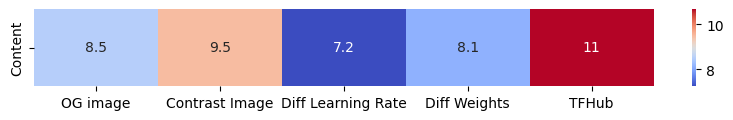

In [ ]:
#viene aperta l'immagine di contenuto e convertita in un array numpy
content = Image.open(CONTENT_IMAGE)
content = np.array(content)
#viene espanso l'asse dell'array in modo che abbia una dimensione di batch
content = np.expand_dims(content, axis=0)
#vengono normalizzati i valori dell'array nell'intervallo [0, 1]
content = img_as_float(content)

#le immagini di output vengono convertite da tensori numpy in float
#La conversione serve per evitare problemi di saturazione o perdita di precisione durante il calcolo del PSNR
tfhub_content = img_as_float(stylized_image.numpy())
vgg19_content_og = img_as_float(image_vgg19.numpy())
vgg19_content_contrast = img_as_float(image_vgg19_CONTRAST.numpy())
vgg19_content_lr = img_as_float(image_vgg19_LR.numpy())
vgg19_content_weights = img_as_float(image_vgg19_WEIGHT.numpy())

#a questo punto viene calcolato il psnr traogni immagine e quella di contenuto
#data_range rappresenta l'intervallo massimo possibile per i valori dei pixel nelle immagini.
psnr_value_vgg19_og = psnr(content, vgg19_content_og, data_range = 1.0)
psnr_value_vgg19_contrast = psnr(content, vgg19_content_contrast, data_range = 1.0)
psnr_value_vgg19_lr = psnr(content, vgg19_content_lr, data_range = 1.0)
psnr_value_vgg19_weights = psnr(content, vgg19_content_weights, data_range = 1.0)
psnr_value_baseline = psnr(content, tfhub_content , data_range = 1.0)

#viene creato un dataframe, in cui si hanno i nomi dei modelli come colonne e il valore psnr delle immagini di contenuto come unica riga
data = {
    'OG image': [psnr_value_vgg19_og],
    'Contrast Image': [psnr_value_vgg19_contrast],
    'Diff Learning Rate': [psnr_value_vgg19_lr],
    'Diff Weights': [psnr_value_vgg19_weights],
    'TFHub': [psnr_value_baseline]
}
df = pd.DataFrame(data, index=['Content'])

#viene selezionata solo la prima riga del DataFrame
first_row = df.iloc[0:1, :]

#viene creata la heatmap
plt.figure(figsize=(10, 1))  # Imposta le dimensioni del grafico
sns.heatmap(first_row, annot=True, cmap='coolwarm', cbar=True, xticklabels=True, yticklabels=True)
plt.savefig('dataset_folder/images/OG/ValuationHEATMAP.png', dpi=300) #l'immagine viene salvata nel percorso specificato
plt.show()

Per il modello VGG19 si nota una maggiore varianza tra i PSNR value tra gli esempi generati. Escludendo la baseline (Tf-Hub) l'esempio che permette di ottenere un'immagine il più possibile fedele a quella di contenuto è l'immagine modificata con il contrasto aumentato. Questo risultato potrebbe essere giustificato dal fatto che, aumentando il contrasto di un'immagine in questa risultino più evidenti (quindi meglio estraibili) i contorni importanti dell'immagine di contenuto. Anche in questo caso la conferma di un miglior mantenimento di contenuto la si trova anche guardando il plot delle immagini generate da VGG19. Mentre le altre non hanno dei contorni ben definiti, l'esempio con il PSNR value maggiore traccia delle linee dell'immagine di contento molto più nette rispetto gli altri.

MobileNetV2

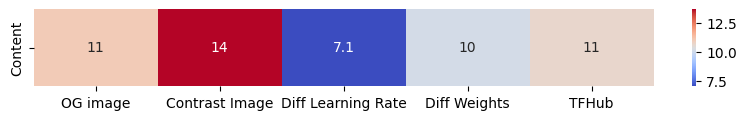

In [ ]:
#viene aperta l'immagine di contenuto e convertita in un array numpy
content = Image.open(CONTENT_IMAGE)
content = np.array(content)
#viene espanso l'asse dell'array in modo che abbia una dimensione di batch
content = np.expand_dims(content, axis=0)
#vengono normalizzati i valori dell'array nell'intervallo [0, 1]
content = img_as_float(content)

#le immagini di output vengono convertite da tensori numpy in float
#La conversione serve per evitare problemi di saturazione o perdita di precisione durante il calcolo del PSNR
tfhub_content = img_as_float(stylized_image.numpy())
mobilenetv2_content_og = img_as_float(image_mobilenetv2.numpy())
mobilenetv2_content_contrast = img_as_float(image_mobilenetv2_CONTRAST.numpy())
mobilenetv2_content_lr = img_as_float(image_mobilenetv2_LR.numpy())
mobilenetv2_content_weights = img_as_float(image_mobilenetv2_WEIGHT.numpy())

#a questo punto viene calcolato il psnr traogni immagine e quella di contenuto
#data_range rappresenta l'intervallo massimo possibile per i valori dei pixel nelle immagini.
psnr_value_mobilenetv2_og = psnr(content, mobilenetv2_content_og, data_range = 1.0)
psnr_value_mobilenetv2_contrast = psnr(content, mobilenetv2_content_contrast, data_range = 1.0)
psnr_value_mobilenetv2_lr = psnr(content, mobilenetv2_content_lr, data_range = 1.0)
psnr_value_mobilenetv2_weights = psnr(content, mobilenetv2_content_weights, data_range = 1.0)
psnr_value_baseline = psnr(content, tfhub_content , data_range = 1.0)

#viene creato un dataframe, in cui si hanno i nomi dei modelli come colonne e il valore psnr delle immagini di contenuto come unica riga
data = {
    'OG image': [psnr_value_mobilenetv2_og],
    'Contrast Image': [psnr_value_mobilenetv2_contrast],
    'Diff Learning Rate': [psnr_value_mobilenetv2_lr],
    'Diff Weights': [psnr_value_mobilenetv2_weights],
    'TFHub': [psnr_value_baseline]
}
df = pd.DataFrame(data, index=['Content'])

#viene selezionata solo la prima riga del DataFrame
first_row = df.iloc[0:1, :]

#viene selezionata la heatmap
plt.figure(figsize=(10, 1))  # Imposta le dimensioni del grafico
sns.heatmap(first_row, annot=True, cmap='coolwarm', cbar=True, xticklabels=True, yticklabels=True)
plt.savefig('dataset_folder/images/OG/ValuationHEATMAP.png', dpi=300)
plt.show()

Come succede per il VGG19 anche in questo caso l'immagine che ha mantenuto meglio il contenuto è quella con il contrasto elevato. C'è anche da dire che in generale il modello si è comportato meglio nel mantenimento del contenuto eccetto che per il learning rate differente che in questo caso è stato aumentato. Un aumento del LR in questo caso porta ad avere nell'immagine generata delle linee di contorni meno definite e un inserimento del nuovo stile più irregolare. Quest'ultima considerazione è confermata anche dal plot dell'immagine generata in cui è molto difficile omprendere il contenuto dell'immagine rispetto alle altre e anche lo stile presente non è affatto inserito bene.

ResNet50

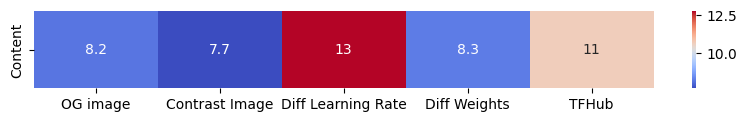

In [ ]:
#viene aperta l'immagine di contenuto e convertita in un array numpy
content = Image.open(CONTENT_IMAGE)
content = np.array(content)
#viene espanso l'asse dell'array in modo che abbia una dimensione di batch
content = np.expand_dims(content, axis=0)
#vengono normalizzati i valori dell'array nell'intervallo [0, 1]
content = img_as_float(content)

#le immagini di output vengono convertite da tensori numpy in float
#La conversione serve per evitare problemi di saturazione o perdita di precisione durante il calcolo del PSNR
tfhub_content = img_as_float(stylized_image.numpy())
resnet50_content_og = img_as_float(image_resnet50.numpy())
resnet50_content_contrast = img_as_float(image_resnet50_CONTRAST.numpy())
resnet50_content_lr = img_as_float(image_resnet50_LR.numpy())
resnet50_content_weights = img_as_float(image_resnet50_WEIGHT.numpy())

#a questo punto viene calcolato il psnr traogni immagine e quella di contenuto
#data_range rappresenta l'intervallo massimo possibile per i valori dei pixel nelle immagini.
psnr_value_resnet50_og = psnr(content, resnet50_content_og, data_range = 1.0)
psnr_value_resnet50_contrast = psnr(content, resnet50_content_contrast, data_range = 1.0)
psnr_value_resnet50_lr = psnr(content, resnet50_content_lr, data_range = 1.0)
psnr_value_resnet50_weights = psnr(content, resnet50_content_weights, data_range = 1.0)
psnr_value_baseline = psnr(content, tfhub_content , data_range = 1.0)

#viene creato un dataframe, in cui si hanno i nomi dei modelli come colonne e il valore psnr delle immagini di contenuto come unica riga
data = {
    'OG image': [psnr_value_resnet50_og],
    'Contrast Image': [psnr_value_resnet50_contrast],
    'Diff Learning Rate': [psnr_value_resnet50_lr],
    'Diff Weights': [psnr_value_resnet50_weights],
    'TFHub': [psnr_value_baseline]
}
df = pd.DataFrame(data, index=['Content'])

#viene selezionata solo la prima riga del DataFrame
first_row = df.iloc[0:1, :]

#viene creata la heatmap
plt.figure(figsize=(10, 1))  # Imposta le dimensioni del grafico
sns.heatmap(first_row, annot=True, cmap='coolwarm', cbar=True, xticklabels=True, yticklabels=True)
plt.savefig('dataset_folder/images/OG/ValuationHEATMAP.png', dpi=300)
plt.show()

Per quanto riguarda il modello preaddestrao ResNet50 l'esempio più simile rispetto all'immagine di contenuto è quello con un differente learning rate, più precisamente con il learning rate più basso. Come detto prima un learning rate basso porta ad dei contorni più segnati e nitidi. L'altro canto possiamo osservare un'"anomalia" in quanto l'immagine che ha il PSNR value in questo caso è quella con il contrasto elevato, ciò va in contraddizione con quello che è stato detto commentando i risultati degli altri modelli preaddestrati. Infatti in questo caso ciò che è stato generato da ResNet50 avendo come immagine di partenza la stessa modificandone solo il contrasto è stata un'immagine non con i contorni nitidi come ci si sarebbe aspettato da qualche altro modello visto in precedenza ma lo stile risulta più prevalente a discapito del mantenimento dell'immagine di contenuto.

## Confronto delle immagini ottenute
Nelle successive celle, per ogni modello, verranno visualizzate le quattro immagini ottenute, seguite dai plot delle loss ottenute in base al cambiamento effettuato.
Le loss ottenute in seguito al cambiamento dei pesi vengono visualizzate tramite dei grafici differenti, in quanto presentano scale diverse rispetto alle altre loss (ottenute tutte con pesi uguali) e risultano graficamente 'piatte', compromettendo quindi l'analisi grafica del risultato ottenuto.

### VGG16

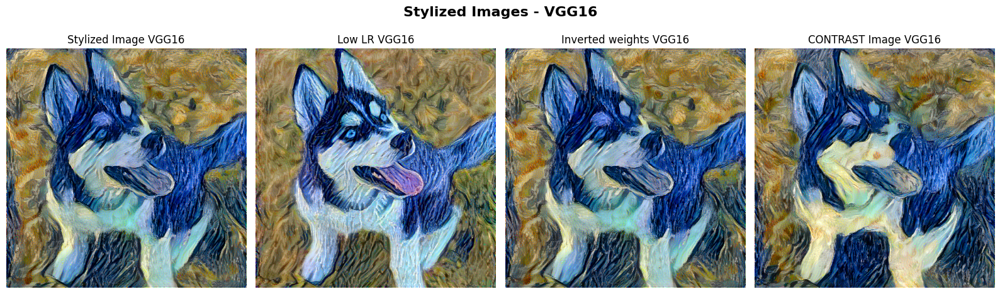

In [ ]:
#visualizzazione di tutte le immagini ottenute con il modello VGG16 una di fianco all'altra
plt.figure(figsize=(16, 5))

plt.suptitle("Stylized Images - VGG16", fontsize=16, fontweight='bold')

plt.subplot(1, 4, 1)
plt.imshow(tensor_to_image(image_list_vgg16[-1]))
plt.title("Stylized Image VGG16")
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(tensor_to_image(image_list_vgg16_LR[-1]))
plt.title("Low LR VGG16")
plt.axis('off')

plt.subplot(1, 4, 3)
plt.imshow(tensor_to_image(image_list_vgg16_WEIGHT[-1]))
plt.title("Inverted weights VGG16")
plt.axis('off')

plt.subplot(1, 4, 4)
plt.imshow(tensor_to_image(image_list_vgg16_CONTRAST[-1]))
plt.title("CONTRAST Image VGG16")
plt.axis('off')

plt.tight_layout()
plt.show()


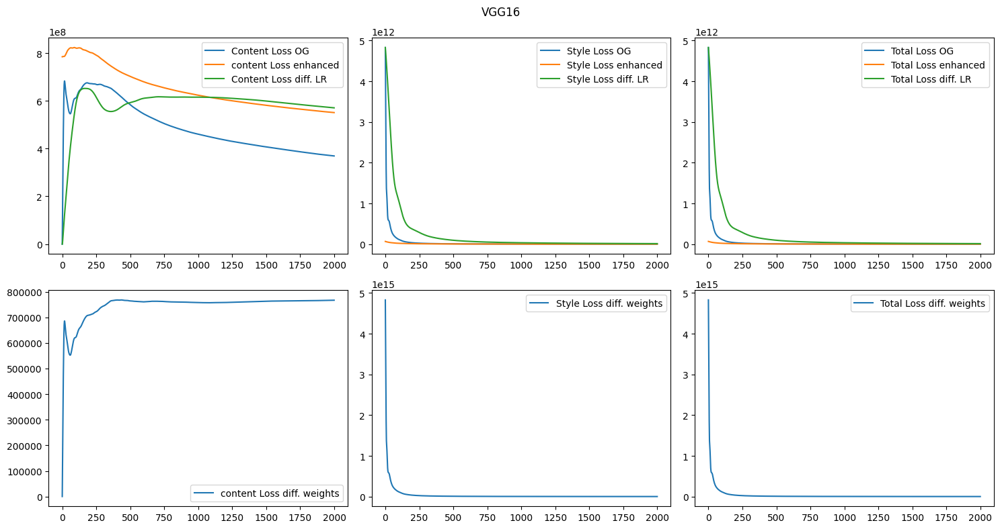

In [ ]:
#visualizzazione di tutte le curve di loss ottenute con il modello VGG16, raggruppate per stile, contenuto e loss totale
plt.figure(figsize=(15, 8))
plt.subplot(2, 3, 1)
plt.plot(content_history_vgg16, label='Content Loss OG')
plt.plot(content_history_vgg16_CONTRAST, label='content Loss enhanced')
plt.plot(content_history_vgg16_LR, label='Content Loss diff. LR')
plt.legend()
plt.subplot(2, 3, 2)
plt.plot(style_history_vgg16, label='Style Loss OG')
plt.plot(style_history_vgg16_CONTRAST, label='Style Loss enhanced')
plt.plot(style_history_vgg16_LR, label='Style Loss diff. LR')
plt.legend()
plt.subplot(2, 3, 3)
plt.plot(total_history_vgg16, label='Total Loss OG')
plt.plot(total_history_vgg16_CONTRAST, label='Total Loss enhanced')
plt.plot(total_history_vgg16_LR, label='Total Loss diff. LR')
plt.legend()

#le loss degli addestramenti con pesi diversi vengono visualizzate sotto perchè presentano scale diverse rispetto alle altre loss.
plt.subplot(2, 3, 4)
plt.plot(content_history_vgg16_WEIGHT, label='content Loss diff. weights')
plt.legend()
plt.subplot(2, 3, 5)
plt.plot(style_history_vgg16_WEIGHT, label='Style Loss diff. weights')
plt.legend()
plt.subplot(2, 3, 6)
plt.plot(total_history_vgg16_WEIGHT, label='Total Loss diff. weights')
plt.legend()

plt.suptitle('VGG16')
plt.savefig('dataset_folder/images/VGG16LOSS.png', dpi=300)
plt.tight_layout()
plt.show()

Il motivo per cui non si possono mettere tutte le curve di loss dello stesso tipo nello stesso grafico è che per l'esempio dove i pesi sono invertiti la scala della curva cambia drasticamente aumentando o diminuendo di molto, perciò per non rischiare di vedere delle curve totalmente piatte abbiamo deciso di dividere il grafico per le loss dell'esempio con i pesi invertiti dagli altri.
* Content LOSS:
  * Content loss OG = tra il 250 esimo e il 500 esimo step inizia a scendere in maniera regolare
  * Content loss diff LR = tra il 750 esimo step e il 1000 esimo si stabilizza e incomincia a scendere molto gradualmente dal 1250 esimo in poi
  * Content loss enhanced = parte con dei valori più alti rispetto alla curva dell'immagine originale tuttavia il periodo di diminuzione della loss incomincia sempre tra il 250 esimo e la 500 esimo step
  * Content loss diff wheights = si stabilizza circa dal 500 esimo step in poi.

Da notare che eccetto che per l'esempio in cui i pesi sono invertiti in tutti gli altri casi anche al 2000 esimo step la perdita sul contenuto sembra stia continuando a diminuire, tuttavia abbiamo deciso di stoppare l'addestramento dato che questa continua diminuzione non portava ad alcun miglioramento apparente sia nella curva della loss totale che rimane sempre molto più correlata alla loss dello stile (avendo questa una scala molto superiore) che visuale osservando i risultati ottenuti.

Per quanto riguarda lo stile le curve sono tutte abbastanza simili, le poche differenze sono il fatto che la curva dell'immagine con contrasto maggiore parta con una perdita bassa fin da subito mentre le altre hanno valori prima molto alti poi dopo i primi 200 step di addestramento sono tutti scesi e stabilizzati. Un'altra differenza sicuramente è la stabilizzazione delle diverse curve, ci sono quelle che si stabilizzano subito e quelle che ci mettono pià step di addestramento per farlo, comunque tutti i valori saranno più o meno stabili tra il 250 esimo e il 500 esimo step in poi.


### VGG19


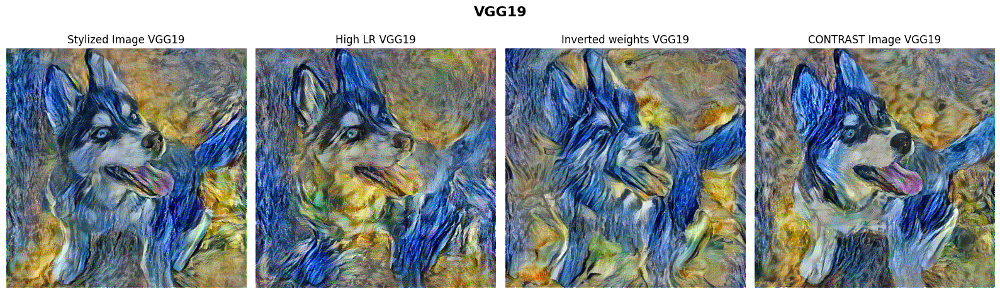

In [ ]:
#visualizzazione di tutte le immagini ottenute con il modello VGG16 una di fianco all'altra
plt.figure(figsize=(16, 5))

plt.suptitle("VGG19", fontsize=16, fontweight='bold')

plt.subplot(1, 4, 1)
plt.imshow(tensor_to_image(image_list_vgg19[-1]))
plt.title("Stylized Image VGG19")
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(tensor_to_image(image_list_vgg19_LR[-1]))
plt.title("High LR VGG19")
plt.axis('off')

plt.subplot(1, 4, 3)
plt.imshow(tensor_to_image(image_list_vgg19_WEIGHT[-1]))
plt.title("Inverted weights VGG19")
plt.axis('off')

plt.subplot(1, 4, 4)
plt.imshow(tensor_to_image(image_list_vgg19_CONTRAST[-1]))
plt.title("CONTRAST Image VGG19")
plt.axis('off')

plt.tight_layout()
plt.show()

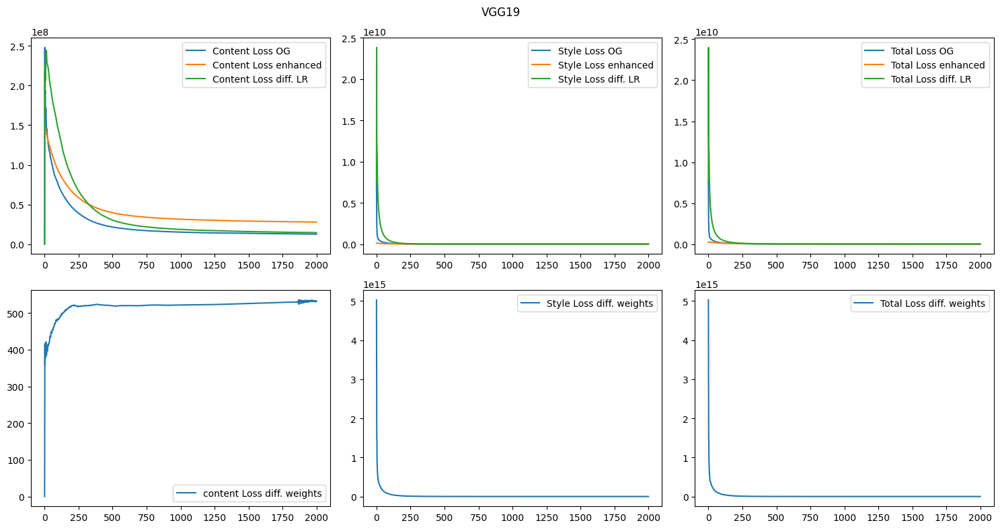

In [ ]:
#visualizzazione di tutte le curve di loss ottenute con il modello VGG19, raggruppate per stile, contenuto e loss totale
plt.figure(figsize=(15, 8))
plt.subplot(2, 3, 1)
plt.plot(content_history_vgg19, label='Content Loss OG')
plt.plot(content_history_vgg19_CONTRAST, label='Content Loss enhanced')
plt.plot(content_history_vgg19_LR, label='Content Loss diff. LR')
plt.legend()
plt.subplot(2, 3, 2)
plt.plot(style_history_vgg19, label='Style Loss OG')
plt.plot(style_history_vgg19_CONTRAST, label='Style Loss enhanced')
plt.plot(style_history_vgg19_LR, label='Style Loss diff. LR')
plt.legend()
plt.subplot(2, 3, 3)
plt.plot(total_history_vgg19, label='Total Loss OG')
plt.plot(total_history_vgg19_CONTRAST, label='Total Loss enhanced')
plt.plot(total_history_vgg19_LR, label='Total Loss diff. LR')
plt.legend()

#le loss degli addestramenti con pesi diversi vengono visualizzate sotto perchè presentano scale diverse rispetto alle altre loss.
plt.subplot(2, 3, 4)
plt.plot(content_history_vgg19_WEIGHT, label='content Loss diff. weights')
plt.legend()
plt.subplot(2, 3, 5)
plt.plot(style_history_vgg19_WEIGHT, label='Style Loss diff. weights')
plt.legend()
plt.subplot(2, 3, 6)
plt.plot(total_history_vgg19_WEIGHT, label='Total Loss diff. weights')
plt.legend()

plt.suptitle('VGG19')
plt.savefig('dataset_folder/images/VGG19LOSS.png', dpi=300)
plt.tight_layout()
plt.show()

* Content LOSS:
  * Content loss OG = verso il 500 passo di addestramento la loss sarà diminuita di molto e tenderà ad abbassarsi sempre di meno fino a stabilizzarsi quasi completamente
  * Content loss diff LR = tra il 750 esimo e il 1000 esimo step si stabilizzano i valori e la loss diminuisce sempre di più
  * Content loss enhanced = si stabilizza circa come l'immagine OG, ciò che cambia anche in questo caso è il valore al quale si stabilizza, maggiore rispetto all'immagine addestrata senza cambiamenti.
  * Content loss diff wheights = a differenza delle altre parte da un valore basso ed aumenta esponenzialmente sempre di più per poi alla fine tra il 250 esimo e il 500 esimo passo di addestramento stabilizzarsi. Possiamo notare anche se per poco una perdita di stabilità negli ultimi steps ma non sembra rilevante per la curva di loss totale in cui questi non appaiono.

  Per quanto riguarda le curve di loss dello stile e quella totale sono praticamente identite e anche gli andamenti degli esempi sono gli stessi. Entro i primi 100 steps tutte le curve sono stabilizzate con valori pressocché costanti.

  Diciamo che da questi grafici si deduce che il processo di addestramento per questo modello sarebbe bene da bloccare anche a partire del 750 esimo step in quanto le loss di contenuto (quelle che cambiano maggiormente) smettono di modificarsi. Anzi dal punto di vista dell'immagine con i pesi invertiti sembra anche che questa aumenti piano piano.



###MobileNetV2

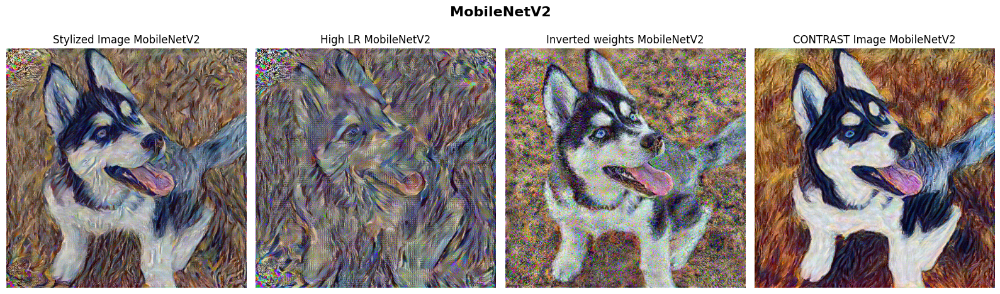

In [ ]:
#visualizzazione di tutte le immagini ottenute con il modello MobileNetV2 una di fianco all'altra
plt.figure(figsize=(16, 5))

plt.suptitle("MobileNetV2", fontsize=16, fontweight='bold')

plt.subplot(1, 4, 1)
plt.imshow(tensor_to_image(image_list_mobilenetv2[-1]))
plt.title("Stylized Image MobileNetV2")
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(tensor_to_image(image_list_mobilenetv2_LR[-1]))
plt.title("High LR MobileNetV2")
plt.axis('off')

plt.subplot(1, 4, 3)
plt.imshow(tensor_to_image(image_list_mobilenetv2_WEIGHT[-1]))
plt.title("Inverted weights MobileNetV2")
plt.axis('off')

plt.subplot(1, 4, 4)
plt.imshow(tensor_to_image(image_list_mobilenetv2_CONTRAST[-1]))
plt.title("CONTRAST Image MobileNetV2")
plt.axis('off')

plt.tight_layout()
plt.show()

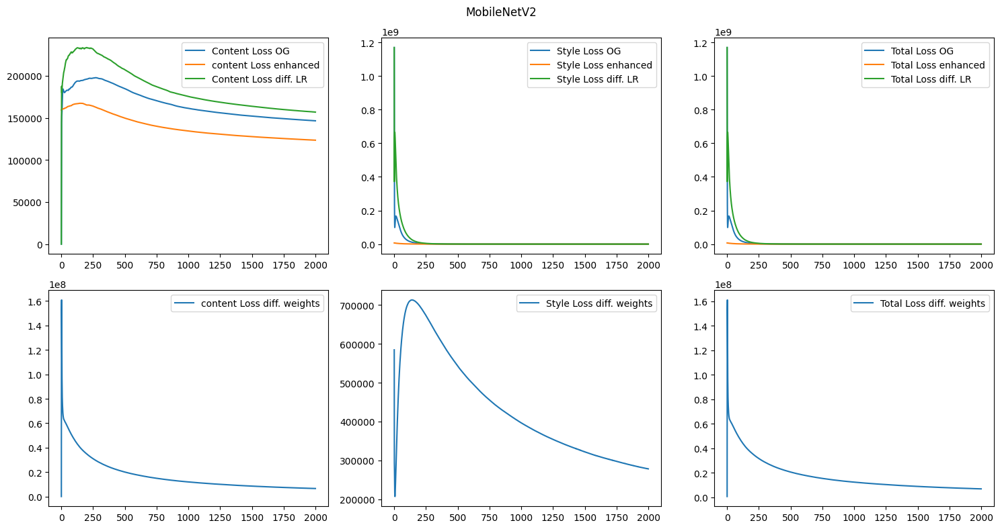

In [ ]:
#visualizzazione di tutte le curve di loss ottenute con il modello VGG19, raggruppate per stile, contenuto e loss totale
plt.figure(figsize=(15, 8))
plt.subplot(2, 3, 1)
plt.plot(content_history_mnv2, label='Content Loss OG')
plt.plot(content_history_mnv2_CONTRAST, label='content Loss enhanced')
plt.plot(content_history_mnv2_LR, label='Content Loss diff. LR')
plt.legend()
plt.subplot(2, 3, 2)
plt.plot(style_history_mnv2, label='Style Loss OG')
plt.plot(style_history_mnv2_CONTRAST, label='Style Loss enhanced')
plt.plot(style_history_mnv2_LR, label='Style Loss diff. LR')
plt.legend()
plt.subplot(2, 3, 3)
plt.plot(total_history_mnv2, label='Total Loss OG')
plt.plot(total_history_mnv2_CONTRAST, label='Total Loss enhanced')
plt.plot(total_history_mnv2_LR, label='Total Loss diff. LR')
plt.legend()

#le loss degli addestramenti con pesi diversi vengono visualizzate sotto perchè presentano scale diverse rispetto alle altre loss.
plt.subplot(2, 3, 4)
plt.plot(content_history_mnv2_WEIGHT, label='content Loss diff. weights')
plt.legend()
plt.subplot(2, 3, 5)
plt.plot(style_history_mnv2_WEIGHT, label='Style Loss diff. weights')
plt.legend()
plt.subplot(2, 3, 6)
plt.plot(total_history_mnv2_WEIGHT, label='Total Loss diff. weights')
plt.legend()


plt.suptitle('MobileNetV2')
plt.savefig('dataset_folder/images/MobileNetV2LOSS.png', dpi=300)
plt.tight_layout()
plt.show()

* Content LOSS:
  * Content loss OG = la discesa si stabilizza verso il millessimo step, i valori di partenza invece sono più alti rispetto alla curva dell'esempio con il contrasto ma più bassi rispetto alla curva dell'esempio con un differente LR.
  * Content loss diff LR = la discesa si stabilizza verso il 1000 esimo step ed è la curva tra le tre del grafico che anche stabilizzata avrà i valori maggiori.
  * Content loss enhanced = la discrsa si stabilizza verso il 1000 esimo passo ed è la curva che ha i valori più bassi (tra le tre curve del grafico).
  * Content loss diff wheights = ha un picco per il primo step poi scende in modo molto graduale fino ad arrivare alla fine dell'addestramento dove non sembra aver trovato ancora un minimo.

Per quanto riguarda le curve di stile sono uguali anche per la curva di loss totale eccetto che per il caso in cui i pesi sono invertiti. In quel caso l'andamento segue quello della curva di loss per il contenuto, quindi continua a scendere sempre di più fino al 2000 esimo step senza trovare ancora un minimo. Ciò è dato dal fatto che il contenuto in questo caso ha un peso estremamente maggiore rispetto a quello dello stile perciò influenzerà maggiormente la loss totale.


###ResNet50

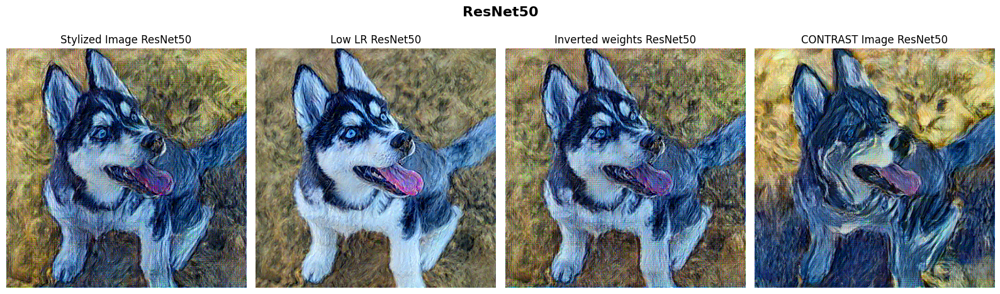

In [ ]:
#visualizzazione di tutte le immagini ottenute con il modello ResNet50 una di fianco all'altra
plt.figure(figsize=(16, 5))

plt.suptitle("ResNet50", fontsize=16, fontweight='bold')

plt.subplot(1, 4, 1)
plt.imshow(tensor_to_image(image_list_resnet50[-1]))
plt.title("Stylized Image ResNet50")
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(tensor_to_image(image_list_resnet50_LR[-1]))
plt.title("Low LR ResNet50")
plt.axis('off')

plt.subplot(1, 4, 3)
plt.imshow(tensor_to_image(image_list_resnet50_WEIGHT[-1]))
plt.title("Inverted weights ResNet50")
plt.axis('off')

plt.subplot(1, 4, 4)
plt.imshow(tensor_to_image(image_list_resnet50_CONTRAST[-1]))
plt.title("CONTRAST Image ResNet50")
plt.axis('off')

plt.tight_layout()
plt.show()

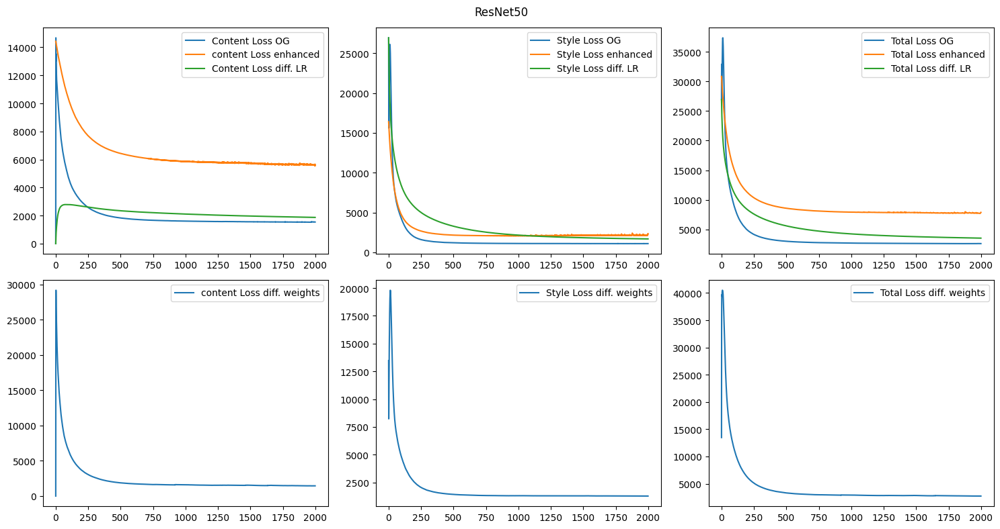

In [ ]:
#visualizzazione di tutte le curve di loss ottenute con il modello VGG19, raggruppate per stile, contenuto e loss totale
plt.figure(figsize=(15, 8))
plt.subplot(2, 3, 1)
plt.plot(content_history_rn50, label='Content Loss OG')
plt.plot(content_history_rn50_CONTRAST, label='content Loss enhanced')
plt.plot(content_history_rn50_LR, label='Content Loss diff. LR')
plt.legend()
plt.subplot(2, 3, 2)
plt.plot(style_history_rn50, label='Style Loss OG')
plt.plot(style_history_rn50_CONTRAST, label='Style Loss enhanced')
plt.plot(style_history_rn50_LR, label='Style Loss diff. LR')
plt.legend()
plt.subplot(2, 3, 3)
plt.plot(total_history_rn50, label='Total Loss OG')
plt.plot(total_history_rn50_CONTRAST, label='Total Loss enhanced')
plt.plot(total_history_rn50_LR, label='Total Loss diff. LR')
plt.legend()

#le loss degli addestramenti con pesi diversi vengono visualizzate sotto perchè presentano scale diverse rispetto alle altre loss.
plt.subplot(2, 3, 4)
plt.plot(content_history_rn50_WEIGHT, label='content Loss diff. weights')
plt.legend()
plt.subplot(2, 3, 5)
plt.plot(style_history_rn50_WEIGHT, label='Style Loss diff. weights')
plt.legend()
plt.subplot(2, 3, 6)
plt.plot(total_history_rn50_WEIGHT, label='Total Loss diff. weights')
plt.legend()

plt.suptitle('ResNet50')
plt.savefig('dataset_folder/images/ResNet50LOSS.png', dpi=300)
plt.tight_layout()
plt.show()

* Content LOSS:
  * Content loss OG = il valore di partenza è alto e si stabilizza qualche step prima rispetto alla curva dell'esempio con il contrasto.
  * Content loss diff LR = la stabilizzazione dei valori avviene verso il 100 step e il valore a cui si stabilizza è simile (un pò più alto rispetto a quello dell'immagine OG)
  * Content loss enhanced = si stabilizza verso il 500 esimo step di addestramento sui valori più alti rispetto a quelli in cui si stabilizzano le curve di loss per il contenuto in tutti gli altri esempi.
  * Content loss diff wheights = la stabilizzazione arriva verso il 500 esimo step di addestramento.

Da notare come a differenza di tutti gli altri modelli preaddestrati le loss in questo caso fanno parte tutte della stessa scala di valori, ciò significa che per la prima volta saranno entrambe (contenuto e stile) a contribuire concretamente alla curva della loss totale. Per i tre esempi assieme avremo una stabilizzazione verso il 500 esimo step con dei valori differenti da esempio ad esempio ma l'ordine rispettato sarà lo stesso del grafico delle curve per la content loss.

Infine la loss totale per l'esempio con i pesi invertiti si stabilizza tra il 250 e il 500 esimo esattamente una via di mezzo tra la curva della content loss e quella dello style loss.

##Considerazioni finali:

Fatto di ogni modello per ognuna delle immagini generate soggettivamente e per un fattore principalmente visivo crediamo che il modello che restituisce una migliore immagine per il task trattato sia VGG16, il modello più semplice tra tutti che però è abbastanza "completo" per essere in grado senza troppi problemi di essere modificato per svolgere un task di neural style transfer. Rispetto alla baseline utilizzata invece c'è da dire che come tutti gli altri modelli dipende davvero tanto dalle immagini che capitano sia per il contenuto che per lo stile, tuttavia per lo stile di Van Gogh non sembra la migliore ne dal punto di vista della qualità visiva soggettiva dell'immagine che dal punto di vista delle metriche che abbiamo calcolato per valutarne la qualità.

C'è da dire inoltre come è stato già detto prima che tutti gli esempi sono dati da un addestramento fatto da noi, se si decide di eseguire tutto il codice da capo le immagini di partenza non saranno le stesse perciò verranno prodotti risulati sia visivi che delle metriche differenti che probabilmente non sarebbero coerenti con tutti i commenti che sono stati fatti appositamente sulle metriche e i risultati dati dall'addestramento con quelle specifiche immagini.

Alla fine siamo soddisfatti dei risultati che abbiamo ottenuto e di ciò che abbiamo scoperto provando diversi modelli senza restare ad utilizzare sempre lo stesso modello usato sempre per questo task (VGG19) che risulta si ottimo ma non ci è sembrato il migliore.

Se avessimo avuto più tempo sicuramente ci saremmo sofferemati sul fornire maggiori esempi magari di modifica dell'immagine come cambiare tipo di contrasto o fare altre tipologie di modifiche come la posterizzazione, l'esposizione o il diminuire il numero di colori disponibili per l'immagine. Un'altra cosa che avremmo potuto sicuramente aggiungere con più tempo è il provare a cambiare tipo di ottimizzatore in quanto seppur Adam funzioni molto bene diverse pubblicazioni ed articoli che abbiamo consultato dicono che il migliore sarebbe L-BFGS.